In [0]:
# import appropriate libraries
import pandas as pd
import numpy as np
from scipy import stats
import seaborn as sns
%matplotlib inline
import matplotlib.pyplot as plt

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [0]:
# # mount drive
# from google.colab import drive
# drive.mount('/content/drive', force_remount=True)

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


## Data Collection and Aggregation

In [0]:
# import liquor data
path= "/content/drive/My Drive/Iowa_Liquor_Sales_2017(inc).csv"
liq = pd.read_csv(path)

In [0]:
# descriptive stats
liq.head()

,Invoice/Item Number,Date,Store Number,Store Name,Address,City,Zip Code,Store Location,County Number,County,Category,Category Name,Vendor Number,Vendor Name,Item Number,Item Description,Pack,Bottle Volume (ml),State Bottle Cost,State Bottle Retail,Bottles Sold,Sale (Dollars),Volume Sold (Liters),Volume Sold (Gallons)
0,INV-13533100006,07/30/2018,3833,Wal-Mart 3394 / Atlantic,1905 East 7th St,Atlantic,50022.0,POINT (-94.98571 41.403853),15.0,CASS,1041100.0,American Dry Gins,434,LUXCO INC,31658,Paramount Gin,6,1750,7.11,10.67,12,128.04,21.00,5.55
1,INV-13556600007,07/31/2018,4490,Casey's General Store #2766 / Cedar Rapids,380 33rd Ave SW,Cedar Rapids,52404.0,POINT (-91.67222100000001 41.944954),57.0,LINN,1031100.0,American Vodkas,434,LUXCO INC,36308,Hawkeye Vodka,6,1750,7.17,10.76,6,64.56,10.50,2.77
2,INV-13533600006,07/30/2018,4114,After 5 Somewhere,704 W 7th St Po Box 372,Atlantic,50022.0,POINT (-95.023116 41.40406200000001),15.0,CASS,1081400.0,American Schnapps,434,LUXCO INC,84457,Paramount Peach Schnapps,12,1000,5.42,8.13,12,97.56,12.00,3.17
3,INV-13558100010,07/31/2018,3932,Main Street Spirits / Mapleton,311 Main St,Mapleton,51034.0,POINT (-95.79375 42.165915),67.0,MONONA,1081300.0,American Cordials & Liqueur,434,LUXCO INC,76488,Paramount Amaretto,6,1750,8.07,12.11,6,72.66,10.50,2.77
4,INV-13567900007,07/31/2018,3484,Jeff's Foods,110 W Cedar St,Marcus,51035.0,POINT (-95.808579 42.825681),18.0,CHEROKEE,1051100.0,American Brandies,434,LUXCO INC,55506,Paramount Cherry Flavored Brandy,12,750,5.48,8.22,3,24.66,2.25,0.59


In [0]:
#rename columns to lower case
liq.rename(columns=lambda x: x.lower(), inplace=True)

In [0]:
# check d-types
liq.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 604619 entries, 0 to 604618
Data columns (total 24 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   invoice/item number    604619 non-null  object 
 1   date                   604619 non-null  object 
 2   store number           604619 non-null  int64  
 3   store name             604619 non-null  object 
 4   address                600654 non-null  object 
 5   city                   600654 non-null  object 
 6   zip code               600654 non-null  float64
 7   store location         545013 non-null  object 
 8   county number          600654 non-null  float64
 9   county                 600654 non-null  object 
 10  category               604569 non-null  float64
 11  category name          604569 non-null  object 
 12  vendor number          604619 non-null  int64  
 13  vendor name            604619 non-null  object 
 14  item number            604619 non-nu

In [0]:
# change date to datetime
liq['date']= pd.to_datetime(liq['date'])

In [0]:
# create column with with year info for easability of merging later
liq['year']= liq['date'].dt.year

In [0]:
# define missingness summary 
def missingness_summary(df, **kwargs):
    s = df.isna().sum()*100/len(df)

    sort = 'desc'
    if kwargs.get('sort'):
        sort = kwargs.get('sort')
    if sort == 'asc':
        s.sort_values(ascending=True, inplace=True)
    elif sort == 'desc':
        s.sort_values(ascending=False, inplace=True)

    print_log = False
    if kwargs.get('print_log'):
        print_log = kwargs.get('print_log')
    if print_log == True:
        print(s)

    return s

In [0]:
# find nulls
missing= missingness_summary(liq)
missing.head(20)

store location           9.858440
address                  0.655785
city                     0.655785
zip code                 0.655785
county number            0.655785
county                   0.655785
category name            0.008270
category                 0.008270
year                     0.000000
date                     0.000000
store number             0.000000
store name               0.000000
vendor number            0.000000
volume sold (gallons)    0.000000
vendor name              0.000000
item number              0.000000
item description         0.000000
pack                     0.000000
bottle volume (ml)       0.000000
state bottle cost        0.000000
dtype: float64

In [0]:
# drop store location, address, vendor name, and vendor number 
liq.drop(['store location', 'address', 'vendor name', 'vendor number'], axis=1, inplace=True)

In [0]:
# fill nulls for store 3420 using rows with complete data for store 3420
nan_cols= liq[['city', 'zip code', 'county number', 'county']]

store1 = liq.loc[liq['store number'] == 3420]

for col in nan_cols.columns:
    mode = store1[col].mode()
    store1[col] = store1[col].fillna(mode)
store1

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,invoice/item number,date,store number,store name,city,zip code,county number,county,category,category name,item number,item description,pack,bottle volume (ml),state bottle cost,state bottle retail,bottles sold,sale (dollars),volume sold (liters),volume sold (gallons),year
1649,INV-03047700033,2017-02-02,3420,Sam's Club 6344 / Windsor Heights,NaN,NaN,NaN,NaN,1092100.0,Imported Distilled Spirit Specialty,75087,Juarez Gold Dss,12,1000,5.17,7.76,156,1151.28,156.0,41.21,2017
1844,INV-02550000004,2017-01-05,3420,Sam's Club 6344 / Windsor Heights,NaN,NaN,NaN,NaN,1041100.0,American Dry Gins,31657,Paramount Gin,12,1000,4.30,6.45,12,77.40,12.0,3.17,2017
1901,INV-02799600001,2017-01-19,3420,Sam's Club 6344 / Windsor Heights,NaN,NaN,NaN,NaN,1081300.0,American Cordials & Liqueur,76487,Paramount Amaretto,12,1000,4.05,6.08,12,72.96,12.0,3.17,2017
1931,INV-02926700006,2017-01-26,3420,Sam's Club 6344 / Windsor Heights,NaN,NaN,NaN,NaN,1081400.0,American Schnapps,81207,Paramount Peppermint Schnapps,12,1000,4.06,6.09,24,146.16,24.0,6.34,2017
1932,INV-02926700004,2017-01-26,3420,Sam's Club 6344 / Windsor Heights,NaN,NaN,NaN,NaN,1041100.0,American Dry Gins,31657,Paramount Gin,12,1000,4.30,6.45,12,77.40,12.0,3.17,2017
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
603768,INV-13465500052,2018-07-26,3420,Sam's Club 6344 / Windsor Heights,Windsor Heights,50311.0,77.0,Polk,1092100.0,Imported Distilled Spirit Specialty,75087,Juarez Gold Dss,12,1000,5.17,7.76,60,465.60,60.0,15.85,2018
603806,INV-13465500016,2018-07-26,3420,Sam's Club 6344 / Windsor Heights,Windsor Heights,50311.0,77.0,Polk,1041100.0,American Dry Gins,31657,Paramount Gin,12,1000,4.30,6.45,12,77.40,12.0,3.17,2018
604368,INV-13465500008,2018-07-26,3420,Sam's Club 6344 / Windsor Heights,Windsor Heights,50311.0,77.0,Polk,1062200.0,White Rum,45277,Paramount White Rum,12,1000,4.42,6.63,36,238.68,36.0,9.51,2018
604381,INV-13465500014,2018-07-26,3420,Sam's Club 6344 / Windsor Heights,Windsor Heights,50311.0,77.0,Polk,1081400.0,American Schnapps,81207,Paramount Peppermint Schnapps,12,1000,4.06,6.09,12,73.08,12.0,3.17,2018


In [0]:
# fill nulls for all stores using rows with complete info for those stores 
stores = []
for store_no in liq['store number'].unique():
    store = liq.loc[liq['store number'] == store_no]
    append_this = True
    for col in nan_cols.columns:
        mode = store[col].mode()
        if len(mode) <1:
          append_this = False
          break
        mode = store[col].mode()
        store[col] = store[col].fillna(mode)
    stores.append(store)
new_liq = pd.concat(stores, axis=0)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if sys.path[0] == '':


In [0]:
# check out new df
new_liq

,invoice/item number,date,store number,store name,city,zip code,county number,county,category,category name,item number,item description,pack,bottle volume (ml),state bottle cost,state bottle retail,bottles sold,sale (dollars),volume sold (liters),volume sold (gallons),year
0,INV-13533100006,2018-07-30,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022.0,15.0,CASS,1041100.0,American Dry Gins,31658,Paramount Gin,6,1750,7.11,10.67,12,128.04,21.00,5.55,2018
951,INV-13533100009,2018-07-30,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022.0,15.0,CASS,1031100.0,American Vodkas,36308,Hawkeye Vodka,6,1750,7.17,10.76,24,258.24,42.00,11.10,2018
1572,INV-16790900011,2019-01-07,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022.0,15.0,CASS,1031100.0,American Vodkas,36308,Hawkeye Vodka,6,1750,7.17,10.76,18,193.68,31.50,8.32,2019
2974,INV-08191800001,2017-10-23,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022.0,15.0,CASS,1062200.0,White Rum,45278,Paramount White Rum,6,1750,7.84,11.76,12,141.12,21.00,5.55,2017
5703,INV-18200700011,2019-03-18,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022.0,15.0,CASS,1031100.0,American Vodkas,36308,Hawkeye Vodka,6,1750,7.17,10.76,18,193.68,31.50,8.32,2019
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
573164,INV-12254800039,2018-05-23,5540,Casey's General Store #2447 / Sergeant Bluff,Sergeant Bluff,51054.0,97.0,WOODBURY,1031100.0,American Vodkas,36305,Hawkeye Vodka,12,750,3.34,5.01,6,30.06,4.50,1.19,2018
573236,INV-12254800019,2018-05-23,5540,Casey's General Store #2447 / Sergeant Bluff,Sergeant Bluff,51054.0,97.0,WOODBURY,1081400.0,American Schnapps,81206,Paramount Peppermint Schnapps,12,750,4.00,6.00,6,36.00,4.50,1.19,2018
573326,INV-12254800038,2018-05-23,5540,Casey's General Store #2447 / Sergeant Bluff,Sergeant Bluff,51054.0,97.0,WOODBURY,1031100.0,American Vodkas,36308,Hawkeye Vodka,6,1750,7.17,10.76,6,64.56,10.50,2.77,2018
574613,INV-12254800020,2018-05-23,5540,Casey's General Store #2447 / Sergeant Bluff,Sergeant Bluff,51054.0,97.0,WOODBURY,1062200.0,White Rum,45275,Paramount White Rum Traveler,12,750,4.00,6.00,3,18.00,2.25,0.59,2018


In [0]:
# check nulls for new df 
missing= missingness_summary(new_liq)
missing.head(10)

city             0.655785
zip code         0.655785
county number    0.655785
county           0.655785
category name    0.008270
category         0.008270
year             0.000000
date             0.000000
store number     0.000000
store name       0.000000
dtype: float64

In [0]:
# create new df with remaining nulls to take a deeper look
null_data = new_liq[new_liq.isnull().any(axis=1)]

In [0]:
# get nulls for city column
null_data.loc[null_data['city'].isna()]

,invoice/item number,date,store number,store name,city,zip code,county number,county,category,category name,item number,item description,pack,bottle volume (ml),state bottle cost,state bottle retail,bottles sold,sale (dollars),volume sold (liters),volume sold (gallons),year
1718,INV-08194200028,2017-10-23,4000,Foodland Super Markets / Woodbine,NaN,NaN,NaN,NaN,1051100.0,American Brandies,54446,Paramount Apricot Flavored Brandy,12,750,5.48,8.22,2,16.44,1.50,0.40,2017
2165,INV-04016600038,2017-03-27,4000,Foodland Super Markets / Woodbine,NaN,NaN,NaN,NaN,1081400.0,American Schnapps,81206,Paramount Peppermint Schnapps,12,750,4.00,6.00,1,5.63,0.75,0.20,2017
2240,INV-04413600026,2017-04-17,4000,Foodland Super Markets / Woodbine,NaN,NaN,NaN,NaN,1081400.0,American Schnapps,81206,Paramount Peppermint Schnapps,12,750,4.00,6.00,2,11.26,1.50,0.40,2017
2244,INV-04413600041,2017-04-17,4000,Foodland Super Markets / Woodbine,NaN,NaN,NaN,NaN,1011100.0,Blended Whiskies,24156,Hawkeye Blend Whiskey,12,750,3.50,5.25,12,63.00,9.00,2.38,2017
2285,INV-04675200037,2017-05-01,4000,Foodland Super Markets / Woodbine,NaN,NaN,NaN,NaN,1062200.0,White Rum,45275,Paramount White Rum Traveler,12,750,4.00,6.00,4,24.00,3.00,0.79,2017
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
285871,INV-06395500014,2017-08-01,9911,North American Spirits,NaN,NaN,NaN,NaN,1022200.0,100% Agave Tequila,87646,Exotico Blanco,12,750,10.00,15.00,3,15.00,2.25,0.59,2017
96415,INV-21439500020,2019-08-23,2693,Hy-Vee Fast & Fresh Express- Creston,NaN,NaN,NaN,NaN,1031100.0,American Vodkas,36305,Hawkeye Vodka,12,750,3.34,5.01,3,15.03,2.25,0.59,2019
96983,INV-21439500019,2019-08-23,2693,Hy-Vee Fast & Fresh Express- Creston,NaN,NaN,NaN,NaN,1031100.0,American Vodkas,36304,Hawkeye Vodka,24,375,1.86,2.79,4,11.16,1.50,0.39,2019
97061,INV-21439500002,2019-08-23,2693,Hy-Vee Fast & Fresh Express- Creston,NaN,NaN,NaN,NaN,1031100.0,American Vodkas,36301,Hawkeye Vodka Mini,12,50,4.13,6.20,12,74.40,0.60,0.15,2019


In [0]:
# look up Central Grocery and New Star later
# then fill with appropriate location info if I have time

In [0]:
# get nulls for category name column
null_data.loc[null_data['category name'].isna()]

,invoice/item number,date,store number,store name,city,zip code,county number,county,category,category name,item number,item description,pack,bottle volume (ml),state bottle cost,state bottle retail,bottles sold,sale (dollars),volume sold (liters),volume sold (gallons),year
245042,INV-16396900001,2018-12-18,5224,Keystone Liquor & Wine / Coralville,Coralville,52241.0,52.0,JOHNSON,NaN,NaN,941836,Everclear 190prf,12,750,10.84,16.26,12,195.12,9.00,2.37,2018
533536,INV-10872100001,2018-03-13,5224,Keystone Liquor & Wine / Coralville,Coralville,52241.0,52.0,JOHNSON,NaN,NaN,941836,Everclear 190prf,12,750,10.84,16.26,12,195.12,9.00,2.38,2018
285087,INV-08354200135,2017-10-31,2552,Hy-Vee Food Store #3 / Cedar Rapids,Cedar Rapids,52404.0,57.0,LINN,NaN,NaN,80128,Ezra Brooks Bourbon Cream Mini,12,50,4.67,7.01,1,84.12,0.05,0.01,2017
47869,INV-19937500001,2019-06-11,2572,Hy-Vee Food Store / Cedar Falls,Cedar Falls,50613.0,7.0,BLACK HAWK,NaN,NaN,941836,Everclear 190prf,12,750,10.84,16.26,36,585.36,27.00,7.13,2019
57491,INV-18666800002,2019-04-09,2572,Hy-Vee Food Store / Cedar Falls,Cedar Falls,50613.0,7.0,BLACK HAWK,NaN,NaN,941836,Everclear 190prf,12,750,10.84,16.26,24,390.24,18.00,4.75,2019
95938,INV-21366600001,2019-08-20,2572,Hy-Vee Food Store / Cedar Falls,Cedar Falls,50613.0,7.0,BLACK HAWK,NaN,NaN,941836,Everclear 190prf,12,750,10.84,16.26,36,585.36,27.00,7.13,2019
130338,INV-22886500001,2019-10-29,2572,Hy-Vee Food Store / Cedar Falls,Cedar Falls,50613.0,7.0,BLACK HAWK,NaN,NaN,941836,Everclear 190prf,12,750,10.84,16.26,60,975.60,45.00,11.88,2019
141170,INV-23333400002,2019-11-19,2572,Hy-Vee Food Store / Cedar Falls,Cedar Falls,50613.0,7.0,BLACK HAWK,NaN,NaN,941836,Everclear 190prf,12,750,10.84,16.26,36,585.36,27.00,7.13,2019
192116,INV-14234800001,2018-09-04,2572,Hy-Vee Food Store / Cedar Falls,Cedar Falls,50613.0,7.0,BLACK HAWK,NaN,NaN,941836,Everclear 190prf,12,750,10.84,16.26,24,390.24,18.00,4.75,2018
195562,INV-14372800001,2018-09-11,2572,Hy-Vee Food Store / Cedar Falls,Cedar Falls,50613.0,7.0,BLACK HAWK,NaN,NaN,941836,Everclear 190prf,12,750,10.84,16.26,24,390.24,18.00,4.75,2018


In [0]:
# find vodka category names 
new_liq.dropna(axis=0).loc[new_liq.dropna(axis=0)['category name'].str.contains('Vodka')]

,invoice/item number,date,store number,store name,city,zip code,county number,county,category,category name,item number,item description,pack,bottle volume (ml),state bottle cost,state bottle retail,bottles sold,sale (dollars),volume sold (liters),volume sold (gallons),year
951,INV-13533100009,2018-07-30,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022.0,15.0,CASS,1031100.0,American Vodkas,36308,Hawkeye Vodka,6,1750,7.17,10.76,24,258.24,42.0,11.10,2018
1572,INV-16790900011,2019-01-07,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022.0,15.0,CASS,1031100.0,American Vodkas,36308,Hawkeye Vodka,6,1750,7.17,10.76,18,193.68,31.5,8.32,2019
5703,INV-18200700011,2019-03-18,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022.0,15.0,CASS,1031100.0,American Vodkas,36308,Hawkeye Vodka,6,1750,7.17,10.76,18,193.68,31.5,8.32,2019
6778,INV-18057600019,2019-03-11,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022.0,15.0,CASS,1031100.0,American Vodkas,36308,Hawkeye Vodka,6,1750,7.17,10.76,24,258.24,42.0,11.09,2019
7080,INV-18339700010,2019-03-25,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022.0,15.0,CASS,1031100.0,American Vodkas,36306,Hawkeye Vodka,12,750,3.34,5.01,12,60.12,9.0,2.37,2019
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
542847,INV-11095200014,2018-03-26,5560,Marion Food Market,Marion,52302.0,57.0,LINN,1031100.0,American Vodkas,36301,Hawkeye Vodka 80 Prf Mini,12,500,4.13,6.20,1,6.20,0.5,0.13,2018
543332,INV-11095200028,2018-03-26,5560,Marion Food Market,Marion,52302.0,57.0,LINN,1031100.0,American Vodkas,36305,Hawkeye Vodka,12,750,3.34,5.01,12,60.12,9.0,2.38,2018
573164,INV-12254800039,2018-05-23,5540,Casey's General Store #2447 / Sergeant Bluff,Sergeant Bluff,51054.0,97.0,WOODBURY,1031100.0,American Vodkas,36305,Hawkeye Vodka,12,750,3.34,5.01,6,30.06,4.5,1.19,2018
573326,INV-12254800038,2018-05-23,5540,Casey's General Store #2447 / Sergeant Bluff,Sergeant Bluff,51054.0,97.0,WOODBURY,1031100.0,American Vodkas,36308,Hawkeye Vodka,6,1750,7.17,10.76,6,64.56,10.5,2.77,2018


In [0]:
# need domain knowledge to fill rows with missing category names appropriately 
# drop remaining null values and move forward
new_liq.dropna(axis=0, inplace=True)

In [0]:
# check for duplicate rows 
dup_rows = new_liq[new_liq.duplicated()]
 
print("Duplicate Rows except first occurrence based on all columns are :")
print(dup_rows)

Duplicate Rows except first occurrence based on all columns are :
Empty DataFrame
Columns: [invoice/item number, date, store number, store name, city, zip code, county number, county, category, category name, item number, item description, pack, bottle volume (ml), state bottle cost, state bottle retail, bottles sold, sale (dollars), volume sold (liters), volume sold (gallons), year]
Index: []


In [0]:
# mount drive for sheets 
from google.colab import auth
auth.authenticate_user()

import gspread
from oauth2client.client import GoogleCredentials

gc = gspread.authorize(GoogleCredentials.get_application_default())

In [0]:
# import population data
worksheet = gc.open('Iowa_pop_and_cn').sheet1

rows = worksheet.get_all_values()
print(rows)

import pandas as pd
pop= pd.DataFrame.from_records(rows)

# make pop dask df
# pop= dd.from_pandas(pop, npartitions=1)

[['county', 'year', 'county number', 'population'], ['ADAIR', 'July 01 2017', '1', '7053'], ['ADAMS', 'July 01 2017', '2', '3663'], ['ALLAMAKEE', 'July 01 2017', '3', '13804'], ['APPANOOSE', 'July 01 2017', '4', '12363'], ['AUDUBON', 'July 01 2017', '5', '5566'], ['BENTON', 'July 01 2017', '6', '25633'], ['BLACK HAWK', 'July 01 2017', '7', '132409'], ['BOONE', 'July 01 2017', '8', '26476'], ['BREMER', 'July 01 2017', '9', '24822'], ['BUCHANAN', 'July 01 2017', '10', '21156'], ['BUENA VISTA', 'July 01 2017', '11', '20102'], ['BUTLER', 'July 01 2017', '12', '14582'], ['CALHOUN', 'July 01 2017', '13', '9749'], ['CARROLL', 'July 01 2017', '14', '20273'], ['CASS', 'July 01 2017', '15', '13126'], ['CEDAR', 'July 01 2017', '16', '18551'], ['CERRO GORDO', 'July 01 2017', '17', '42997'], ['CHEROKEE', 'July 01 2017', '18', '11330'], ['CHICKASAW', 'July 01 2017', '19', '12036'], ['CLARKE', 'July 01 2017', '20', '9331'], ['CLAY', 'July 01 2017', '21', '16153'], ['CLAYTON', 'July 01 2017', '22', '1

In [0]:
# descriptive stats
pop.head()

,0,1,2,3
0,county,year,county number,population
1,ADAIR,July 01 2017,1,7053
2,ADAMS,July 01 2017,2,3663
3,ALLAMAKEE,July 01 2017,3,13804
4,APPANOOSE,July 01 2017,4,12363


In [0]:
# set frist row to columns names
pop.columns = pop.iloc[0]

In [0]:
# drop first row
pop.drop([0], axis=0, inplace=True)
pop.head()

,county,year,county number,population
1,ADAIR,July 01 2017,1,7053
2,ADAMS,July 01 2017,2,3663
3,ALLAMAKEE,July 01 2017,3,13804
4,APPANOOSE,July 01 2017,4,12363
5,AUDUBON,July 01 2017,5,5566


In [0]:
# check d-types
pop.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 198 entries, 1 to 198
Data columns (total 4 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   county         198 non-null    object
 1   year           198 non-null    object
 2   county number  198 non-null    object
 3   population     198 non-null    object
dtypes: object(4)
memory usage: 7.7+ KB


In [0]:
# change population column to numeric
pop.population= pd.to_numeric(pop.population)
pop.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 198 entries, 1 to 198
Data columns (total 4 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   county         198 non-null    object
 1   year           198 non-null    object
 2   county number  198 non-null    object
 3   population     198 non-null    int64 
dtypes: int64(1), object(3)
memory usage: 7.7+ KB


In [0]:
# change year to dt
from datetime import datetime

pop['date'] = pop['year'].apply(lambda x: datetime.strptime(x, '%B %d %Y'))
pop.drop('year', axis=1, inplace=True)
pop.head()

,county,county number,population,date
1,ADAIR,1,7053,2017-07-01
2,ADAMS,2,3663,2017-07-01
3,ALLAMAKEE,3,13804,2017-07-01
4,APPANOOSE,4,12363,2017-07-01
5,AUDUBON,5,5566,2017-07-01


In [0]:
# create year column for merging
pop['year']= pop['date'].dt.year
pop.drop('date', axis=1, inplace=True)
pop.head()

,county,county number,population,year
1,ADAIR,1,7053,2017
2,ADAMS,2,3663,2017
3,ALLAMAKEE,3,13804,2017
4,APPANOOSE,4,12363,2017
5,AUDUBON,5,5566,2017


In [0]:
# get unique county numbers for dfs
print(pop['county number'].nunique())
print(new_liq['county number'].nunique())
print(pop['county number'].unique())
print(new_liq['county number'].unique())

99
99
['1' '2' '3' '4' '5' '6' '7' '8' '9' '10' '11' '12' '13' '14' '15' '16'
 '17' '18' '19' '20' '21' '22' '23' '24' '25' '26' '27' '28' '29' '30'
 '31' '32' '33' '34' '35' '36' '37' '38' '39' '40' '41' '42' '43' '44'
 '45' '46' '47' '48' '49' '50' '51' '52' '53' '54' '55' '56' '57' '58'
 '59' '60' '61' '62' '63' '64' '65' '66' '67' '68' '69' '70' '71' '72'
 '73' '74' '75' '76' '77' '78' '79' '80' '81' '82' '83' '84' '85' '86'
 '87' '88' '89' '90' '91' '92' '93' '94' '95' '96' '97' '98' '99']
[15. 57. 67. 18. 97. 43. 52. 77. 81.  7. 83. 13. 82. 79. 31. 70. 44. 72.
 91. 78. 11. 84.  5. 92.  8. 58. 71. 25. 90. 75. 29.  1. 39. 47. 24. 60.
 16. 53. 94. 54. 48. 74. 17. 85. 23. 30.  6. 42. 46. 69. 64. 59. 61.  3.
 22.  2. 96. 35. 14. 10. 76.  9. 99.  4. 88. 68. 63. 26. 80. 65. 98. 32.
 95. 56. 33. 62. 20. 40. 86. 73. 12. 28. 50. 19. 21. 41. 27. 55. 66. 34.
 37. 93. 89. 49. 38. 87. 45. 51. 36.]


In [0]:
# check d-types of columns that will be merged on 
print(new_liq['county number'].dtype)
print(pop['county number'].dtype)
print(new_liq['year'].dtype)
print(pop['year'].dtype)

float64
object
int64
int64


In [0]:
# change pop county number to float
pop['county number']= pop['county number'].astype('float64')
#print(pop['county number'].dtype)

In [0]:
# drop rows with years I do not have population info for 
new_liq.drop(new_liq.loc[new_liq['year']== 2019].index, axis=0, inplace=True)
new_liq.drop(new_liq.loc[new_liq['year']== 2020].index, axis=0, inplace=True)

In [0]:
# merge dfs 
df_agg= pd.merge(new_liq, pop, on=['county number', 'year'], how='left')
df_agg.head()

,invoice/item number,date,store number,store name,city,zip code,county number,county_x,category,category name,item number,item description,pack,bottle volume (ml),state bottle cost,state bottle retail,bottles sold,sale (dollars),volume sold (liters),volume sold (gallons),year,county_y,population
0,INV-13533100006,2018-07-30,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022.0,15.0,CASS,1041100.0,American Dry Gins,31658,Paramount Gin,6,1750,7.11,10.67,12,128.04,21.0,5.55,2018,CASS,12930
1,INV-13533100009,2018-07-30,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022.0,15.0,CASS,1031100.0,American Vodkas,36308,Hawkeye Vodka,6,1750,7.17,10.76,24,258.24,42.0,11.10,2018,CASS,12930
2,INV-08191800001,2017-10-23,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022.0,15.0,CASS,1062200.0,White Rum,45278,Paramount White Rum,6,1750,7.84,11.76,12,141.12,21.0,5.55,2017,CASS,13126
3,INV-14208300002,2018-08-31,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022.0,15.0,CASS,1062200.0,White Rum,45278,Paramount White Rum,6,1750,7.84,11.76,6,70.56,10.5,2.77,2018,CASS,12930
4,INV-10070600008,2018-01-29,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022.0,15.0,CASS,1031100.0,American Vodkas,36308,Hawkeye Vodka,6,1750,7.17,10.76,12,129.12,21.0,5.55,2018,CASS,12930


In [0]:
# examine which county cols to keep
print(df_agg['county_x'].nunique())
print(df_agg['county_y'].nunique())

131
99


In [0]:
df_agg['county_x'].unique()

array(['CASS', 'LINN', 'MONONA', 'CHEROKEE', 'WOODBURY', 'HARRISON',
       'JOHNSON', 'POLK', 'SAC', 'Polk', 'BLACK HAWK', 'SHELBY',
       'CALHOUN', 'SCOTT', 'POWESHIEK', 'DUBUQUE', 'MUSCATINE', 'HENRY',
       'OSCEOLA', 'WARREN', 'POTTAWATTA', 'BUENA VIST', 'SIOUX',
       'AUDUBON', 'WASHINGTON', 'BOONE', 'LOUISA', 'OBRIEN', 'DALLAS',
       'Henry', 'Wapello', 'PLYMOUTH', 'DES MOINES', 'Adair', 'IDA',
       'Plymouth', 'CRAWFORD', 'LYON', 'CEDAR', 'JONES', 'GUTHRIE',
       'WEBSTER', 'Black Hawk', 'KEOKUK', 'IOWA', 'PALO ALTO',
       'Cerro Gord', 'STORY', 'CLINTON', 'DICKINSON', 'BENTON', 'WAPELLO',
       'Hardin', 'HUMBOLDT', 'MONTGOMERY', 'CERRO GORD', 'MARSHALL',
       'LUCAS', 'MADISON', 'ALLAMAKEE', 'Clayton', 'WINNESHIEK',
       'FRANKLIN', 'CARROLL', 'BUCHANAN', 'POCAHONTAS', 'Boone', 'BREMER',
       'WRIGHT', 'HARDIN', 'APPANOOSE', 'UNION', 'MONROE', 'MARION',
       'DAVIS', 'RINGGOLD', 'MILLS', 'WORTH', 'EMMET', 'WINNEBAGO', 'LEE',
       'FAYETTE', 'MAHASKA', 

In [0]:
# drop county_x because has a mixture of upper and lower case
df_agg.drop('county_x', axis=1, inplace=True)

In [0]:
# store county_y col as county then drop county_y
df_agg['county']= df_agg['county_y']
df_agg.drop('county_y', axis=1, inplace=True)
df_agg

,invoice/item number,date,store number,store name,city,zip code,county number,category,category name,item number,item description,pack,bottle volume (ml),state bottle cost,state bottle retail,bottles sold,sale (dollars),volume sold (liters),volume sold (gallons),year,population,county
0,INV-13533100006,2018-07-30,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022.0,15.0,1041100.0,American Dry Gins,31658,Paramount Gin,6,1750,7.11,10.67,12,128.04,21.00,5.55,2018,12930,CASS
1,INV-13533100009,2018-07-30,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022.0,15.0,1031100.0,American Vodkas,36308,Hawkeye Vodka,6,1750,7.17,10.76,24,258.24,42.00,11.10,2018,12930,CASS
2,INV-08191800001,2017-10-23,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022.0,15.0,1062200.0,White Rum,45278,Paramount White Rum,6,1750,7.84,11.76,12,141.12,21.00,5.55,2017,13126,CASS
3,INV-14208300002,2018-08-31,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022.0,15.0,1062200.0,White Rum,45278,Paramount White Rum,6,1750,7.84,11.76,6,70.56,10.50,2.77,2018,12930,CASS
4,INV-10070600008,2018-01-29,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022.0,15.0,1031100.0,American Vodkas,36308,Hawkeye Vodka,6,1750,7.17,10.76,12,129.12,21.00,5.55,2018,12930,CASS
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
396515,INV-12254800039,2018-05-23,5540,Casey's General Store #2447 / Sergeant Bluff,Sergeant Bluff,51054.0,97.0,1031100.0,American Vodkas,36305,Hawkeye Vodka,12,750,3.34,5.01,6,30.06,4.50,1.19,2018,102539,WOODBURY
396516,INV-12254800019,2018-05-23,5540,Casey's General Store #2447 / Sergeant Bluff,Sergeant Bluff,51054.0,97.0,1081400.0,American Schnapps,81206,Paramount Peppermint Schnapps,12,750,4.00,6.00,6,36.00,4.50,1.19,2018,102539,WOODBURY
396517,INV-12254800038,2018-05-23,5540,Casey's General Store #2447 / Sergeant Bluff,Sergeant Bluff,51054.0,97.0,1031100.0,American Vodkas,36308,Hawkeye Vodka,6,1750,7.17,10.76,6,64.56,10.50,2.77,2018,102539,WOODBURY
396518,INV-12254800020,2018-05-23,5540,Casey's General Store #2447 / Sergeant Bluff,Sergeant Bluff,51054.0,97.0,1062200.0,White Rum,45275,Paramount White Rum Traveler,12,750,4.00,6.00,3,18.00,2.25,0.59,2018,102539,WOODBURY


In [0]:
# import education data
worksheet = gc.open('Iowa education').sheet1

# get_all_values gives a list of rows.
rows = worksheet.get_all_values()
print(rows)

import pandas as pd
df= pd.DataFrame.from_records(rows)

[['county', 'county number', 'Margin of Error!!Percent MOE!!Population 25 years and over!!Population 35 to 44 years!!High school graduate or higher', "Estimate!!Total!!Population 25 years and over!!Population 35 to 44 years!!Bachelor's degree or higher", "Margin of Error!!Total MOE!!Population 25 years and over!!Population 35 to 44 years!!Bachelor's degree or higher", "Estimate!!Percent!!Population 25 years and over!!Population 35 to 44 years!!Bachelor's degree or higher", "Margin of Error!!Percent MOE!!Population 25 years and over!!Population 35 to 44 years!!Bachelor's degree or higher", "Estimate!!Female!!Population 25 years and over!!Population 35 to 44 years!!Bachelor's degree or higher", "Margin of Error!!Female MOE!!Population 25 years and over!!Population 35 to 44 years!!Bachelor's degree or higher", "Estimate!!Percent Female!!Population 25 years and over!!Population 35 to 44 years!!Bachelor's degree or higher", "Margin of Error!!Percent Female MOE!!Population 25 years and over!

In [0]:
# clean
df.columns = df.iloc[0]
df.drop([0], axis=0, inplace=True)
df = df[df.columns.drop(list(df.filter(regex='Male')))]
df = df[df.columns.drop(list(df.filter(regex='Female')))]
df = df[df.columns.drop(list(df.filter(regex='RACE')))]
df = df[df.columns.drop(list(df.filter(regex='POVERTY')))]
df = df[df.columns.drop(list(df.filter(regex='Margin')))]
df = df[df.columns.drop(list(df.filter(regex='High school')))]
df = df[df.columns.drop(list(df.filter(regex='INFLATION')))]
df = df[df.columns.drop(list(df.filter(regex='no diploma')))]
df = df[df.columns.drop(list(df.filter(regex='9th')))]
df = df[df.columns.drop(list(df.filter(regex='no degree')))]
df = df[df.columns.drop(list(df.filter(regex='high school graduate')))]
df.replace('(X)',np.nan).dropna(axis=1,how="all")
df = df[df.columns.drop(list(df.filter(regex='65')))]
df = df[df.columns.drop(list(df.filter(regex='Graduate')))]
df

,county,county number,Estimate!!Total!!Population 25 years and over!!Population 35 to 44 years!!Bachelor's degree or higher,Estimate!!Percent!!Population 25 years and over!!Population 35 to 44 years!!Bachelor's degree or higher,Estimate!!Total!!Population 25 years and over!!Population 45 to 64 years,Estimate!!Percent!!Population 25 years and over!!Population 45 to 64 years,Estimate!!Total!!Population 25 years and over!!Population 45 to 64 years!!Bachelor's degree or higher,Estimate!!Percent!!Population 25 years and over!!Population 45 to 64 years!!Bachelor's degree or higher,Estimate!!Total!!Population 18 to 24 years,Estimate!!Percent!!Population 18 to 24 years,Estimate!!Total!!Population 18 to 24 years!!Some college or associate's degree,Estimate!!Percent!!Population 18 to 24 years!!Some college or associate's degree,Estimate!!Total!!Population 18 to 24 years!!Bachelor's degree or higher,Estimate!!Percent!!Population 18 to 24 years!!Bachelor's degree or higher,Estimate!!Total!!Population 25 years and over,Estimate!!Percent!!Population 25 years and over,Estimate!!Total!!Population 25 years and over!!Associate's degree,Estimate!!Percent!!Population 25 years and over!!Associate's degree,Estimate!!Total!!Population 25 years and over!!Bachelor's degree,Estimate!!Percent!!Population 25 years and over!!Bachelor's degree,Estimate!!Total!!Population 25 years and over!!Bachelor's degree or higher,Estimate!!Percent!!Population 25 years and over!!Bachelor's degree or higher,Estimate!!Total!!Population 25 years and over!!Population 25 to 34 years,Estimate!!Percent!!Population 25 years and over!!Population 25 to 34 years,Estimate!!Total!!Population 25 years and over!!Population 25 to 34 years!!Bachelor's degree or higher,Estimate!!Percent!!Population 25 years and over!!Population 25 to 34 years!!Bachelor's degree or higher,Estimate!!Total!!Population 25 years and over!!Population 35 to 44 years,Estimate!!Percent!!Population 25 years and over!!Population 35 to 44 years
1,Adair,1,93,12.5,2033,(X),325,16,467,(X),199,42.6,35,7.5,5114,(X),707,13.8,594,11.6,790,15.4,772,(X),174,22.5,743,(X)
2,Adams,2,52,14.1,1083,(X),172,15.9,248,(X),94,37.9,2,0.8,2700,(X),386,14.3,371,13.7,478,17.7,407,(X),110,27,368,(X)
3,Allamakee,3,364,26.7,3893,(X),702,18,1017,(X),429,42.2,85,8.4,9688,(X),1166,12,1329,13.7,1792,18.5,1410,(X),283,20.1,1365,(X)
4,Appanoose,4,245,19,3462,(X),633,18.3,841,(X),296,35.2,39,4.6,8917,(X),1012,11.3,1078,12.1,1523,17.1,1327,(X),331,24.9,1292,(X)
5,Audubon,5,78,13.8,1697,(X),266,15.7,403,(X),192,47.6,31,7.7,4137,(X),524,12.7,431,10.4,602,14.6,502,(X),71,14.1,564,(X)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,Winnebago,95,398,35.4,2895,(X),660,22.8,1069,(X),618,57.8,74,6.9,7205,(X),1007,14,1190,16.5,1612,22.4,1046,(X),252,24.1,1124,(X)
96,Winneshiek,96,798,39,5560,(X),1480,26.6,3209,(X),2617,81.6,218,6.8,13434,(X),2016,15,2362,17.6,3989,29.7,1872,(X),582,31.1,2045,(X)
97,Woodbury,97,3364,27.1,24791,(X),5548,22.4,10162,(X),4919,48.4,704,6.9,65382,(X),6357,9.7,10452,16,15047,23,13395,(X),3108,23.2,12420,(X)
98,Worth,98,141,17.2,2203,(X),378,17.2,613,(X),306,49.9,92,15,5268,(X),777,14.7,593,11.3,819,15.5,764,(X),146,19.1,820,(X)


In [0]:
ed= df[['county', 'county number', 'Estimate!!Total!!Population 25 years and over!!Bachelor\'s degree or higher', 'Estimate!!Percent!!Population 25 years and over!!Bachelor\'s degree', 'Estimate!!Percent!!Population 18 to 24 years!!Bachelor\'s degree or higher', 'Estimate!!Total!!Population 18 to 24 years', 'Estimate!!Total!!Population 25 years and over']].copy()
ed['county']= ed['county'].str.upper()
ed.rename(columns={'Estimate!!Total!!Population 25 years and over!!Bachelor\'s degree or higher':'total_ed'}, inplace=True)
ed.rename(columns={'Estimate!!Percent!!Population 25 years and over!!Bachelor\'s degree': 'percent_ed'}, inplace=True)
ed.rename(columns={'Estimate!!Percent!!Population 18 to 24 years!!Bachelor\'s degree or higher':'percent_under_25_ed'}, inplace=True)
ed.rename(columns={'Estimate!!Total!!Population 18 to 24 years':'total_under_25_pop'}, inplace=True)
ed.rename(columns={'Estimate!!Total!!Population 25 years and over':'total_over_25_pop'}, inplace=True)
ed

,county,county number,total_ed,percent_ed,percent_under_25_ed,total_under_25_pop,total_over_25_pop
1,ADAIR,1,790,11.6,7.5,467,5114
2,ADAMS,2,478,13.7,0.8,248,2700
3,ALLAMAKEE,3,1792,13.7,8.4,1017,9688
4,APPANOOSE,4,1523,12.1,4.6,841,8917
5,AUDUBON,5,602,10.4,7.7,403,4137
...,...,...,...,...,...,...,...
95,WINNEBAGO,95,1612,16.5,6.9,1069,7205
96,WINNESHIEK,96,3989,17.6,6.8,3209,13434
97,WOODBURY,97,15047,16,6.9,10162,65382
98,WORTH,98,819,11.3,15,613,5268


In [0]:
# check out d-types of ed
ed.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 99 entries, 1 to 99
Data columns (total 7 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   county               99 non-null     object
 1   county number        99 non-null     object
 2   total_ed             99 non-null     object
 3   percent_ed           99 non-null     object
 4   percent_under_25_ed  99 non-null     object
 5   total_under_25_pop   99 non-null     object
 6   total_over_25_pop    99 non-null     object
dtypes: object(7)
memory usage: 6.2+ KB


In [0]:
# change non-object columns to numeric 
cols = ed.columns.drop('county')

ed[cols] = ed[cols].apply(pd.to_numeric, errors='coerce')

ed.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 99 entries, 1 to 99
Data columns (total 7 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   county               99 non-null     object 
 1   county number        99 non-null     int64  
 2   total_ed             99 non-null     int64  
 3   percent_ed           99 non-null     float64
 4   percent_under_25_ed  99 non-null     float64
 5   total_under_25_pop   99 non-null     int64  
 6   total_over_25_pop    99 non-null     int64  
dtypes: float64(2), int64(4), object(1)
memory usage: 6.2+ KB


In [0]:
# check out d-types of df_agg
df_agg.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 396520 entries, 0 to 396519
Data columns (total 22 columns):
 #   Column                 Non-Null Count   Dtype         
---  ------                 --------------   -----         
 0   invoice/item number    396520 non-null  object        
 1   date                   396520 non-null  datetime64[ns]
 2   store number           396520 non-null  int64         
 3   store name             396520 non-null  object        
 4   city                   396520 non-null  object        
 5   zip code               396520 non-null  float64       
 6   county number          396520 non-null  float64       
 7   category               396520 non-null  float64       
 8   category name          396520 non-null  object        
 9   item number            396520 non-null  int64         
 10  item description       396520 non-null  object        
 11  pack                   396520 non-null  int64         
 12  bottle volume (ml)     396520 non-null  int6

In [0]:
# convert county number d-type
df_agg['county number']= df_agg['county number'].astype('int64')

In [0]:
# merge df_agg and ed
df= pd.merge(df_agg, ed, on=['county number'], how='left')
df

,invoice/item number,date,store number,store name,city,zip code,county number,category,category name,item number,item description,pack,bottle volume (ml),state bottle cost,state bottle retail,bottles sold,sale (dollars),volume sold (liters),volume sold (gallons),year,population,county_x,county_y,total_ed,percent_ed,percent_under_25_ed,total_under_25_pop,total_over_25_pop
0,INV-13533100006,2018-07-30,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022.0,15,1041100.0,American Dry Gins,31658,Paramount Gin,6,1750,7.11,10.67,12,128.04,21.00,5.55,2018,12930,CASS,CASS,1849,13.9,4.4,873,9417
1,INV-13533100009,2018-07-30,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022.0,15,1031100.0,American Vodkas,36308,Hawkeye Vodka,6,1750,7.17,10.76,24,258.24,42.00,11.10,2018,12930,CASS,CASS,1849,13.9,4.4,873,9417
2,INV-08191800001,2017-10-23,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022.0,15,1062200.0,White Rum,45278,Paramount White Rum,6,1750,7.84,11.76,12,141.12,21.00,5.55,2017,13126,CASS,CASS,1849,13.9,4.4,873,9417
3,INV-14208300002,2018-08-31,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022.0,15,1062200.0,White Rum,45278,Paramount White Rum,6,1750,7.84,11.76,6,70.56,10.50,2.77,2018,12930,CASS,CASS,1849,13.9,4.4,873,9417
4,INV-10070600008,2018-01-29,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022.0,15,1031100.0,American Vodkas,36308,Hawkeye Vodka,6,1750,7.17,10.76,12,129.12,21.00,5.55,2018,12930,CASS,CASS,1849,13.9,4.4,873,9417
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
396515,INV-12254800039,2018-05-23,5540,Casey's General Store #2447 / Sergeant Bluff,Sergeant Bluff,51054.0,97,1031100.0,American Vodkas,36305,Hawkeye Vodka,12,750,3.34,5.01,6,30.06,4.50,1.19,2018,102539,WOODBURY,WOODBURY,15047,16.0,6.9,10162,65382
396516,INV-12254800019,2018-05-23,5540,Casey's General Store #2447 / Sergeant Bluff,Sergeant Bluff,51054.0,97,1081400.0,American Schnapps,81206,Paramount Peppermint Schnapps,12,750,4.00,6.00,6,36.00,4.50,1.19,2018,102539,WOODBURY,WOODBURY,15047,16.0,6.9,10162,65382
396517,INV-12254800038,2018-05-23,5540,Casey's General Store #2447 / Sergeant Bluff,Sergeant Bluff,51054.0,97,1031100.0,American Vodkas,36308,Hawkeye Vodka,6,1750,7.17,10.76,6,64.56,10.50,2.77,2018,102539,WOODBURY,WOODBURY,15047,16.0,6.9,10162,65382
396518,INV-12254800020,2018-05-23,5540,Casey's General Store #2447 / Sergeant Bluff,Sergeant Bluff,51054.0,97,1062200.0,White Rum,45275,Paramount White Rum Traveler,12,750,4.00,6.00,3,18.00,2.25,0.59,2018,102539,WOODBURY,WOODBURY,15047,16.0,6.9,10162,65382


In [0]:
# keep 1 county column called county 
df['county']= df['county_y']
df.drop(['county_y', 'county_x'], axis=1, inplace=True)

# create col for total under 25 educated 
df['total_under_25_ed']= df['percent_under_25_ed']* df['population']

# create col for percent drinking population under 25
df['percent_under_25_pop']= round((df['total_under_25_pop']/ df['population'])*100,1)

# create col for percent drinking population
df['percent_over_25_pop']= round((df['total_over_25_pop']/ df['population'])*100,1)

# create col for percent drinking population
df['percent_drink_pop']= df['percent_under_25_pop']+ df['percent_over_25_pop']
df.head()

,invoice/item number,date,store number,store name,city,zip code,county number,category,category name,item number,item description,pack,bottle volume (ml),state bottle cost,state bottle retail,bottles sold,sale (dollars),volume sold (liters),volume sold (gallons),year,population,total_ed,percent_ed,percent_under_25_ed,total_under_25_pop,total_over_25_pop,county,total_under_25_ed,percent_under_25_pop,percent_over_25_pop,percent_drink_pop
0,INV-13533100006,2018-07-30,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022.0,15,1041100.0,American Dry Gins,31658,Paramount Gin,6,1750,7.11,10.67,12,128.04,21.0,5.55,2018,12930,1849,13.9,4.4,873,9417,CASS,56892.0,6.8,72.8,79.6
1,INV-13533100009,2018-07-30,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022.0,15,1031100.0,American Vodkas,36308,Hawkeye Vodka,6,1750,7.17,10.76,24,258.24,42.0,11.10,2018,12930,1849,13.9,4.4,873,9417,CASS,56892.0,6.8,72.8,79.6
2,INV-08191800001,2017-10-23,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022.0,15,1062200.0,White Rum,45278,Paramount White Rum,6,1750,7.84,11.76,12,141.12,21.0,5.55,2017,13126,1849,13.9,4.4,873,9417,CASS,57754.4,6.7,71.7,78.4
3,INV-14208300002,2018-08-31,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022.0,15,1062200.0,White Rum,45278,Paramount White Rum,6,1750,7.84,11.76,6,70.56,10.5,2.77,2018,12930,1849,13.9,4.4,873,9417,CASS,56892.0,6.8,72.8,79.6
4,INV-10070600008,2018-01-29,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022.0,15,1031100.0,American Vodkas,36308,Hawkeye Vodka,6,1750,7.17,10.76,12,129.12,21.0,5.55,2018,12930,1849,13.9,4.4,873,9417,CASS,56892.0,6.8,72.8,79.6


In [0]:
df.drop(['pack', 'store name', 'city', 'county number', 'year'], axis=1, inplace=False)

,invoice/item number,date,store number,zip code,category,category name,item number,item description,bottle volume (ml),state bottle cost,state bottle retail,bottles sold,sale (dollars),volume sold (liters),volume sold (gallons),population,total_ed,percent_ed,percent_under_25_ed,total_under_25_pop,total_over_25_pop,county,total_under_25_ed,percent_under_25_pop,percent_over_25_pop,percent_drink_pop
0,INV-13533100006,2018-07-30,3833,50022.0,1041100.0,American Dry Gins,31658,Paramount Gin,1750,7.11,10.67,12,128.04,21.00,5.55,12930,1849,13.9,4.4,873,9417,CASS,56892.0,6.8,72.8,79.6
1,INV-13533100009,2018-07-30,3833,50022.0,1031100.0,American Vodkas,36308,Hawkeye Vodka,1750,7.17,10.76,24,258.24,42.00,11.10,12930,1849,13.9,4.4,873,9417,CASS,56892.0,6.8,72.8,79.6
2,INV-08191800001,2017-10-23,3833,50022.0,1062200.0,White Rum,45278,Paramount White Rum,1750,7.84,11.76,12,141.12,21.00,5.55,13126,1849,13.9,4.4,873,9417,CASS,57754.4,6.7,71.7,78.4
3,INV-14208300002,2018-08-31,3833,50022.0,1062200.0,White Rum,45278,Paramount White Rum,1750,7.84,11.76,6,70.56,10.50,2.77,12930,1849,13.9,4.4,873,9417,CASS,56892.0,6.8,72.8,79.6
4,INV-10070600008,2018-01-29,3833,50022.0,1031100.0,American Vodkas,36308,Hawkeye Vodka,1750,7.17,10.76,12,129.12,21.00,5.55,12930,1849,13.9,4.4,873,9417,CASS,56892.0,6.8,72.8,79.6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
396515,INV-12254800039,2018-05-23,5540,51054.0,1031100.0,American Vodkas,36305,Hawkeye Vodka,750,3.34,5.01,6,30.06,4.50,1.19,102539,15047,16.0,6.9,10162,65382,WOODBURY,707519.1,9.9,63.8,73.7
396516,INV-12254800019,2018-05-23,5540,51054.0,1081400.0,American Schnapps,81206,Paramount Peppermint Schnapps,750,4.00,6.00,6,36.00,4.50,1.19,102539,15047,16.0,6.9,10162,65382,WOODBURY,707519.1,9.9,63.8,73.7
396517,INV-12254800038,2018-05-23,5540,51054.0,1031100.0,American Vodkas,36308,Hawkeye Vodka,1750,7.17,10.76,6,64.56,10.50,2.77,102539,15047,16.0,6.9,10162,65382,WOODBURY,707519.1,9.9,63.8,73.7
396518,INV-12254800020,2018-05-23,5540,51054.0,1062200.0,White Rum,45275,Paramount White Rum Traveler,750,4.00,6.00,3,18.00,2.25,0.59,102539,15047,16.0,6.9,10162,65382,WOODBURY,707519.1,9.9,63.8,73.7


## EDA

In [0]:
# check feild types
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 396520 entries, 0 to 396519
Data columns (total 31 columns):
 #   Column                 Non-Null Count   Dtype         
---  ------                 --------------   -----         
 0   invoice/item number    396520 non-null  object        
 1   date                   396520 non-null  datetime64[ns]
 2   store number           396520 non-null  int64         
 3   store name             396520 non-null  object        
 4   city                   396520 non-null  object        
 5   zip code               396520 non-null  float64       
 6   county number          396520 non-null  int64         
 7   category               396520 non-null  float64       
 8   category name          396520 non-null  object        
 9   item number            396520 non-null  int64         
 10  item description       396520 non-null  object        
 11  pack                   396520 non-null  int64         
 12  bottle volume (ml)     396520 non-null  int6

In [0]:
# convert d-types
convert_type = ['zip code', 'category']

df[convert_type]= df[convert_type].astype('int64')
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 396520 entries, 0 to 396519
Data columns (total 31 columns):
 #   Column                 Non-Null Count   Dtype         
---  ------                 --------------   -----         
 0   invoice/item number    396520 non-null  object        
 1   date                   396520 non-null  datetime64[ns]
 2   store number           396520 non-null  int64         
 3   store name             396520 non-null  object        
 4   city                   396520 non-null  object        
 5   zip code               396520 non-null  int64         
 6   county number          396520 non-null  int64         
 7   category               396520 non-null  int64         
 8   category name          396520 non-null  object        
 9   item number            396520 non-null  int64         
 10  item description       396520 non-null  object        
 11  pack                   396520 non-null  int64         
 12  bottle volume (ml)     396520 non-null  int6

In [0]:
# make a list with only numeric data
numeric_cols= list(df.select_dtypes(include='float64'))
numeric_cols

['state bottle cost',
 'state bottle retail',
 'sale (dollars)',
 'volume sold (liters)',
 'volume sold (gallons)',
 'percent_ed',
 'percent_under_25_ed',
 'total_under_25_ed',
 'percent_under_25_pop',
 'percent_over_25_pop',
 'percent_drink_pop']

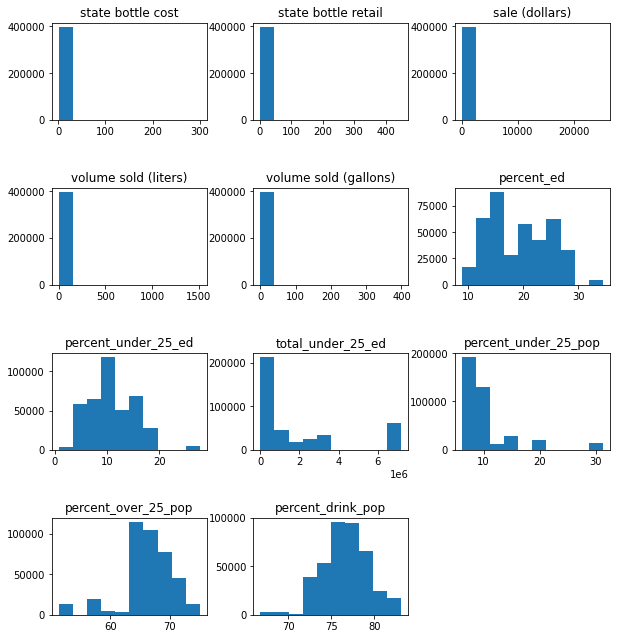

In [0]:
# check distribution of numeric data
plt.figure(figsize=(10,20))
for i, col in enumerate (numeric_cols,1):
  plt.subplot(7,3,i)
  plt.hist(df[col])
  plt.title(col)
  plt.subplots_adjust(wspace=.3, hspace=.7)

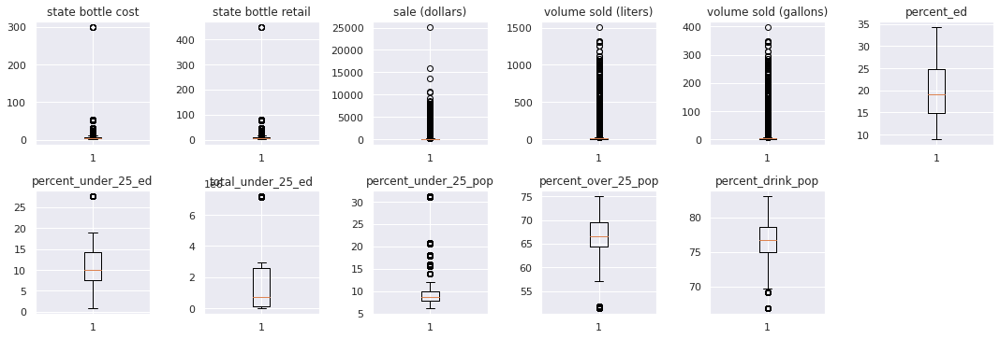

In [0]:
#check for outliers
cols=df.select_dtypes(['float64']).columns

plt.figure(figsize=(15,15))
for i, col in enumerate(cols):
  plt.subplot(6,6,i+1)
  plt.boxplot(df[col], whis=1.5)
  plt.title(col)
plt.tight_layout()
plt.show()

In [0]:
# Since my y variable-sales(dollars) consists of so many outliers, all of which are orders that have to be fileld, I decide not to manipulate them in any way 

In [0]:
# split df based on year 
df_2017= df.loc[df['date'].dt.year== 2017]
df_2018= df.loc[df['date'].dt.year== 2018]

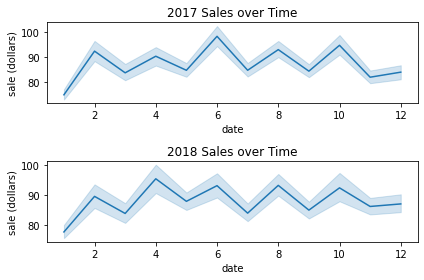

In [0]:
# graph total sales per month 

import seaborn as sns
import matplotlib.pyplot as plt
#sns.set(rc={'figure.figsize':(10 ,6)})

plt.subplot(2,1,1)
x= df_2017['date'].dt.month
y= df_2017['sale (dollars)']
sns.lineplot(x,y)
plt.title('2017 Sales over Time')

plt.subplot(2,1,2)
x= df_2018['date'].dt.month
y= df_2018['sale (dollars)']
sns.lineplot(x,y)
plt.title('2018 Sales over Time')

plt.subplots_adjust(wspace=.5, hspace=1)
plt.tight_layout()

Text(0.5, 1.0, '2017 Sales over Time')

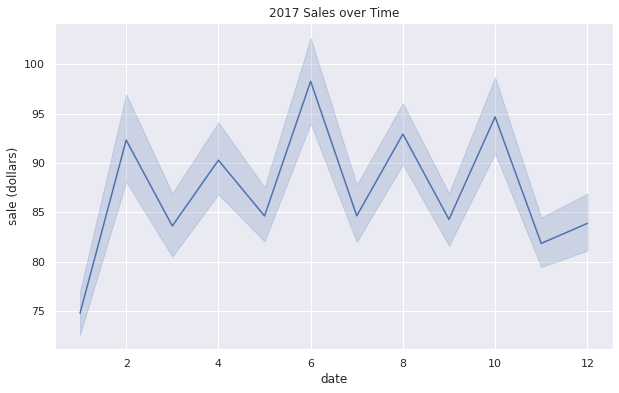

In [0]:
sns.set(rc={'figure.figsize':(10 ,6)})
x= df_2017['date'].dt.month
y= df_2017['sale (dollars)']
sns.lineplot(x,y)
plt.title('2017 Sales over Time')

Text(0.5, 1.0, '2018 Sales over Time')

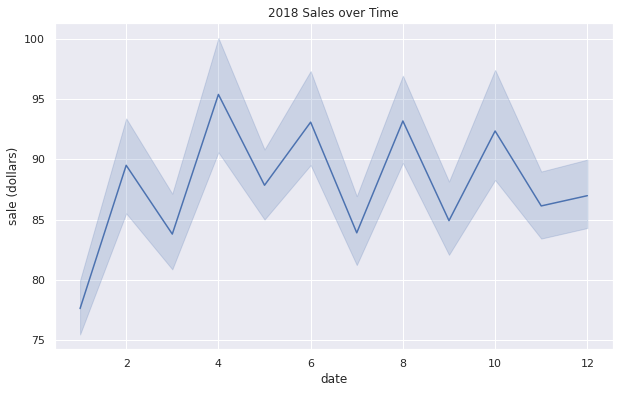

In [0]:
sns.set(rc={'figure.figsize':(10 ,6)})
x= df_2018['date'].dt.month
y= df_2018['sale (dollars)']
sns.lineplot(x,y)
plt.title('2018 Sales over Time')

In [0]:
# bottles sold by category name
df_2017.groupby(['category name']).sum().sort_values('bottles sold', ascending=False)

,store number,zip code,county number,category,item number,pack,bottle volume (ml),state bottle cost,state bottle retail,bottles sold,sale (dollars),volume sold (liters),volume sold (gallons),year,population,total_ed,percent_ed,percent_under_25_ed,total_under_25_pop,total_over_25_pop,total_under_25_ed,percent_under_25_pop,percent_over_25_pop,percent_drink_pop
category name,,,,,,,,,,,,,,,,,,,,,,,,
American Vodkas,243851469,3064345775,3435449,61721646000,2174121834,701586,63953125,281219.59,421995.94,890796,5.962506e+06,920606.49,243222.01,120737620,9841686913,2230536656,1189714.3,675759.2,995660762,6386018647,1.347104e+11,627543.8,3950723.1,4578266.9
Mixto Tequila,29914012,442496272,474654,8819700900,766070679,96060,9067000,76052.20,114082.74,185764,1.987858e+06,188647.00,49832.14,17404693,1246597488,278084720,167870.0,93952.9,130937169,808322841,1.649356e+10,91852.1,570359.4,662211.5
White Rum,73571630,1009543274,1105544,20931713200,895327319,181782,25730875,118317.81,177486.72,178545,1.508345e+06,218153.92,57608.94,39747002,2747737660,607466752,375015.6,209847.1,277648798,1788864368,3.619585e+10,201465.0,1309983.8,1511448.8
American Schnapps,89547149,1256807696,1293103,26440230000,1993838251,306198,22224550,114826.43,172249.54,176374,1.178733e+06,158291.57,41812.54,49315650,2761012258,599585339,449112.9,251309.0,288004095,1800722905,3.504241e+10,247500.4,1633971.2,1881471.6
Triple Sec,18899455,281645126,310163,5946087000,474810734,65976,5039000,16292.95,24441.93,123867,5.318389e+05,120422.75,31812.61,11089466,835337958,187721898,108659.1,60470.4,86779692,541727696,1.120301e+10,58799.5,362653.9,421453.4
American Brandies,57577314,814585159,804819,16701979000,874271130,196758,14265250,99552.26,149357.78,102631,9.454733e+05,90214.28,23832.31,32050130,1344894002,284180168,276286.9,154954.6,139782211,879599078,1.659376e+10,154504.1,1071383.3,1225887.4
American Cordials & Liqueur,46325644,679607287,725392,14329387600,1015757466,152562,11798000,62094.85,93163.31,93792,6.306315e+05,84511.50,22329.43,26729284,1614656622,353585437,247183.3,137324.2,168435909,1049800895,2.081863e+10,137476.9,880734.2,1018211.1
Imported Distilled Spirit Specialty,3201395,46817666,49629,995995200,68479344,10944,912000,4715.04,7077.12,65411,4.827332e+05,65411.00,17279.49,1839504,132251892,28213824,17119.1,8965.7,12675740,86828668,1.677437e+09,8585.1,60904.7,69489.8
American Dry Gins,31999325,458102665,509065,9318886100,280716143,75534,12489750,51867.67,77831.02,63524,5.269120e+05,83906.01,22150.45,18054167,1283640884,286967958,172376.4,95816.9,133428736,831801588,1.710122e+10,96021.5,591255.1,687276.6


In [0]:
# gallons sold by category name 
df_2017.groupby(['category name']).sum().sort_values('volume sold (gallons)', ascending=False)

,store number,zip code,county number,category,item number,pack,bottle volume (ml),state bottle cost,state bottle retail,bottles sold,sale (dollars),volume sold (liters),volume sold (gallons),year,population,total_ed,percent_ed,percent_under_25_ed,total_under_25_pop,total_over_25_pop,total_under_25_ed,percent_under_25_pop,percent_over_25_pop,percent_drink_pop
category name,,,,,,,,,,,,,,,,,,,,,,,,
American Vodkas,243851469,3064345775,3435449,61721646000,2174121834,701586,63953125,281219.59,421995.94,890796,5.962506e+06,920606.49,243222.01,120737620,9841686913,2230536656,1189714.3,675759.2,995660762,6386018647,1.347104e+11,627543.8,3950723.1,4578266.9
White Rum,73571630,1009543274,1105544,20931713200,895327319,181782,25730875,118317.81,177486.72,178545,1.508345e+06,218153.92,57608.94,39747002,2747737660,607466752,375015.6,209847.1,277648798,1788864368,3.619585e+10,201465.0,1309983.8,1511448.8
Mixto Tequila,29914012,442496272,474654,8819700900,766070679,96060,9067000,76052.20,114082.74,185764,1.987858e+06,188647.00,49832.14,17404693,1246597488,278084720,167870.0,93952.9,130937169,808322841,1.649356e+10,91852.1,570359.4,662211.5
American Schnapps,89547149,1256807696,1293103,26440230000,1993838251,306198,22224550,114826.43,172249.54,176374,1.178733e+06,158291.57,41812.54,49315650,2761012258,599585339,449112.9,251309.0,288004095,1800722905,3.504241e+10,247500.4,1633971.2,1881471.6
Triple Sec,18899455,281645126,310163,5946087000,474810734,65976,5039000,16292.95,24441.93,123867,5.318389e+05,120422.75,31812.61,11089466,835337958,187721898,108659.1,60470.4,86779692,541727696,1.120301e+10,58799.5,362653.9,421453.4
American Brandies,57577314,814585159,804819,16701979000,874271130,196758,14265250,99552.26,149357.78,102631,9.454733e+05,90214.28,23832.31,32050130,1344894002,284180168,276286.9,154954.6,139782211,879599078,1.659376e+10,154504.1,1071383.3,1225887.4
American Cordials & Liqueur,46325644,679607287,725392,14329387600,1015757466,152562,11798000,62094.85,93163.31,93792,6.306315e+05,84511.50,22329.43,26729284,1614656622,353585437,247183.3,137324.2,168435909,1049800895,2.081863e+10,137476.9,880734.2,1018211.1
American Dry Gins,31999325,458102665,509065,9318886100,280716143,75534,12489750,51867.67,77831.02,63524,5.269120e+05,83906.01,22150.45,18054167,1283640884,286967958,172376.4,95816.9,133428736,831801588,1.710122e+10,96021.5,591255.1,687276.6
Blended Whiskies,25856545,359126296,400804,7085788800,167993497,59004,9789250,47517.28,71280.09,59408,5.328378e+05,75175.75,19849.17,14135136,880713409,193118758,128762.5,71960.1,88688576,574101533,1.144406e+10,70782.2,467689.0,538471.2


In [0]:
# gallons sold by county 
df_2017.groupby(['county']).sum().sort_values('volume sold (gallons)', ascending=False)

,store number,zip code,county number,category,item number,pack,bottle volume (ml),state bottle cost,state bottle retail,bottles sold,sale (dollars),volume sold (liters),volume sold (gallons),year,population,total_ed,percent_ed,percent_under_25_ed,total_under_25_pop,total_over_25_pop,total_under_25_ed,percent_under_25_pop,percent_over_25_pop,percent_drink_pop
county,,,,,,,,,,,,,,,,,,,,,,,,
POLK,117247782,1583641474,2426886,32966363300,1572382372,347436,32989925,183518.90,275326.09,456738,3.551197e+06,449013.74,118618.86,63571806,15162868548,3564969462,778494.6,466466.4,1314332118,9880136568,2.244105e+11,274206.6,2.054974e+06,2.329180e+06
LINN,57758093,855050471,931266,17164472200,864728820,187532,16781450,92666.72,139026.33,249643,1.836048e+06,246560.81,65133.85,32953746,3664237626,803813262,380675.4,214027.8,338212938,2433169326,4.800151e+10,150309.6,1.084843e+06,1.235153e+06
JOHNSON,33720031,492382905,489996,9860286500,503432045,107905,9611600,55365.67,83062.27,136738,1.091940e+06,136447.98,36045.67,19006191,1406034099,430913790,263844.0,161133.3,292810302,813355668,2.404318e+10,195998.4,5.446494e+05,7.406478e+05
SCOTT,32760827,497238233,772522,9921634900,527176507,101659,9996100,56561.90,84854.97,107456,8.715594e+05,110297.79,29137.55,19002157,1626931332,349406048,188420.0,99862.6,138309701,1096039140,1.724547e+10,80078.5,6.349754e+05,7.150539e+05
BLACK HAWK,35537979,511739010,70707,10613826700,564179614,115125,10426575,60497.50,90760.02,99625,7.635095e+05,99804.32,26364.58,20373717,1337463309,242060364,192929.1,98989.8,206727066,845302185,1.310714e+10,156565.5,6.383832e+05,7.949487e+05
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
DAVIS,795432,13869768,6864,276970500,13082289,2892,257250,1526.23,2289.63,1382,1.120181e+04,1361.75,359.72,532488,2373624,302280,3933.6,1742.4,184800,1474176,1.566592e+07,2059.2,1.639440e+04,1.845360e+04
WAYNE,332025,5867392,10881,122978300,5963497,1080,141750,690.06,1035.21,888,7.020530e+03,984.00,259.81,235989,758862,66222,1041.3,280.8,52650,510354,1.821269e+06,807.3,7.874100e+03,8.681400e+03
TAYLOR,711499,9202465,15747,190099300,8705696,1920,185750,933.69,1400.77,822,6.100850e+03,886.75,234.27,365077,1112788,116202,1918.6,579.2,79459,780834,3.560922e+06,1285.1,1.270620e+04,1.399130e+04


In [0]:
# gallons sold by bottle size 
df_2017.groupby(['bottle volume (ml)']).sum().sort_values('volume sold (gallons)', ascending=False)

,store number,zip code,county number,category,item number,pack,state bottle cost,state bottle retail,bottles sold,sale (dollars),volume sold (liters),volume sold (gallons),year,population,total_ed,percent_ed,percent_under_25_ed,total_under_25_pop,total_over_25_pop,total_under_25_ed,percent_under_25_pop,percent_over_25_pop,percent_drink_pop
bottle volume (ml),,,,,,,,,,,,,,,,,,,,,,,
1750,231209552,3167809477,3440282,64500963000,2604165884,371040,498270.72,747570.49,550409,6.381515e+06,963215.75,254302.56,124731280,8336449590,1854010667,1167875.4,660569.0,845556557,5423014048,1.109042e+11,629304.7,4.116320e+06,4.745625e+06
1000,140514311,2023015352,2143366,41546234700,2392014338,473604,199351.92,299106.39,696845,5.137576e+06,696845.00,184080.47,79604939,4764634374,1039968213,729321.4,397451.0,501213027,3097017172,6.092735e+10,408067.4,2.629604e+06,3.037672e+06
750,278101515,3853808773,4193798,79234939900,4285305658,887660,399967.25,599958.75,690207,4.902407e+06,517655.25,136847.21,151692519,11274034969,2533236105,1466346.7,830066.7,1154051989,7319683856,1.517740e+11,789606.5,4.972941e+06,5.762547e+06
375,51410428,648323307,714797,13257535500,642082232,303600,28129.89,42202.91,185274,5.699850e+05,69475.27,18371.36,25515050,1926984328,433473500,248188.8,140775.8,196879530,1251110922,2.605549e+10,132039.6,8.374539e+05,9.694935e+05
500,32100246,407855899,461830,8295879600,380054783,95364,33821.76,50770.17,39756,2.521277e+05,19878.00,5250.73,16029099,1433664909,324619327,162982.4,91718.0,143716440,932178583,1.950378e+10,83318.2,5.229416e+05,6.062598e+05
200,3160188,42479979,41951,851457200,31365844,39648,968.62,1457.06,28517,4.967066e+04,5703.40,1508.46,1666042,146372647,32953162,17418.7,9952.2,16016764,94729891,1.958972e+09,9487.2,5.377250e+04,6.325970e+04
800,839396,14961444,16624,310619000,18421380,1740,1029.50,1545.70,2224,1.188057e+04,1779.20,470.56,584930,52446447,11937329,6347.2,3653.3,5407804,34049867,7.117090e+08,3173.4,1.884730e+04,2.202070e+04
900,157561,2203790,2688,73147300,4312814,258,330.67,496.22,420,5.164150e+03,378.00,99.94,86731,7443798,1633390,811.9,439.7,677497,4889355,9.865738e+07,398.1,2.885300e+03,3.283400e+03
50,1178715,16208656,17521,419641200,28183135,3792,1626.51,2441.33,1301,1.026492e+04,65.05,16.97,637372,37899579,8325319,5897.2,3152.3,4116851,24600541,4.829855e+08,3335.0,2.099400e+04,2.432900e+04


In [0]:
# create pie charts 
import plotly.express as px

In [0]:
# gallons sold by category name
df_2017_charts= df_2017.copy()

top5 = ['American Vodkas', 'White Rum', 'Mixto Tequila', 'American Schnapps', 'Triple Sec']
df_2017_charts['category name'] = df_2017_charts['category name'].apply(lambda x: x if x in top5 else 'Other')

fig = px.pie(df_2017_charts, values='volume sold (gallons)', names='category name', title='Gallons Sold per Category')
fig.show()

In [0]:
# gallons sold by county 
top10 = df_2017_charts['county'].value_counts(ascending=False).head(10).index
df_2017_charts['county'] = df_2017_charts['county'].apply(lambda x: x if x in top10 else 'Other')

fig = px.pie(df_2017_charts, values='volume sold (gallons)', names='county', title='Gallons Sold per County')
fig.show()

In [0]:
# gallons sold by bottle size 
fig = px.pie(df_2017, values='volume sold (gallons)', names='bottle volume (ml)', title='Gallons Sold by Bottle Size')
fig.show()

In [0]:
# percent under 25 population by county
fig = px.pie(df_2017_charts, values='percent_under_25_ed', names='county', title='Percent Population Under 25 by County')
fig.show()

In [0]:
# percent educated population by county
fig = px.pie(df_2017_charts, values='percent_ed', names='county', title='Percent Educated Population by County')
fig.show()

In [0]:
# group by gallons sold by county
df_2017_grouped =df_2017.groupby('county').agg({'volume sold (gallons)':'sum','percent_ed':'median','percent_under_25_ed':'median', 'percent_under_25_pop':'median', 'percent_over_25_pop':'median',
                               'percent_drink_pop':'median'}).sort_values('volume sold (gallons)', ascending=False)

# subset top 10 and store in new df
df_2017_grouped_top_10 = df_2017_grouped.iloc[0:10, :].reset_index()

# # merge demographic cols 
# df_2017_grouped_top_10 = pd.
df_2017_grouped_top_10

,county,volume sold (gallons),percent_ed,percent_under_25_ed,percent_under_25_pop,percent_over_25_pop,percent_drink_pop
0,POLK,118618.86,24.7,14.8,8.7,65.2,73.9
1,LINN,65133.85,23.3,13.1,9.2,66.4,75.6
2,JOHNSON,36045.67,28.0,17.1,20.8,57.8,78.6
3,SCOTT,29137.55,20.0,10.6,8.5,67.4,75.9
4,BLACK HAWK,26364.58,19.1,9.8,15.5,63.2,78.7
5,STORY,21500.00,28.1,10.0,31.3,51.7,83.0
6,WOODBURY,17488.09,16.0,6.9,10.0,64.1,74.1
7,CERRO GORDO,16894.60,16.1,10.1,8.1,71.3,79.4
8,POTTAWATTAMIE,15737.50,14.8,7.6,8.8,67.5,76.3
9,DUBUQUE,15681.53,19.7,10.7,10.2,66.6,76.8


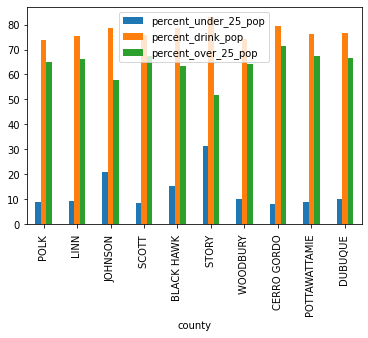

In [0]:
# graph bar plot comapring population demographics
df_2017_grouped_top_10.plot(x="county", y=["percent_under_25_pop", "percent_drink_pop", "percent_over_25_pop"], kind="bar")

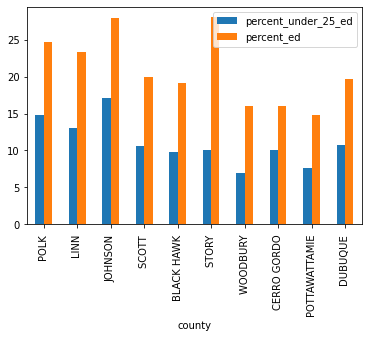

In [0]:
# graph bar plot comapring education demographics
df_2017_grouped_top_10.plot(x="county", y=["percent_under_25_ed", "percent_ed"], kind="bar")

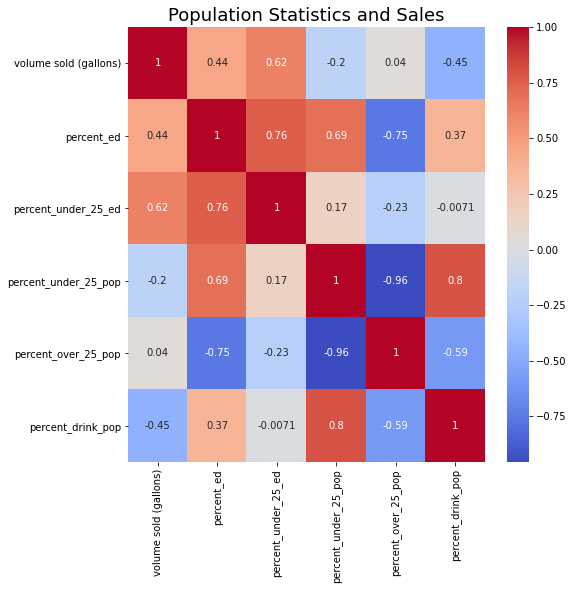

In [0]:
#multivariate corr
plt.figure(figsize=[8, 8])
sns.heatmap(df_2017_grouped_top_10.select_dtypes(include='number').corr(), annot=True, cmap='coolwarm')
plt.title('Population Statistics and Sales', fontsize=18)
plt.show()

Text(0.5, 1.0, '2017 Sales per Category over Time')

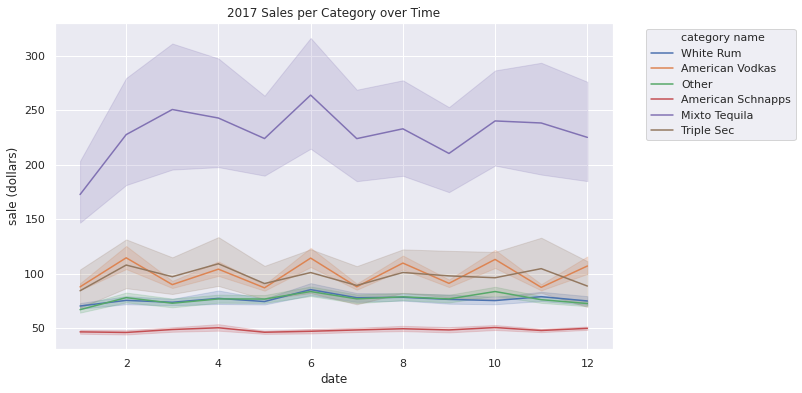

In [0]:
# examine sales by category per month
sns.set(rc={'figure.figsize':(10 ,6)})
ax = sns.lineplot(x=df_2017_charts['date'].dt.month, y=df_2017_charts['sale (dollars)'],
                  hue="category name", data=df_2017_charts)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2)
plt.title('2017 Sales per Category over Time')

Text(0.5, 1.0, '2018 Sales per Category over Time')

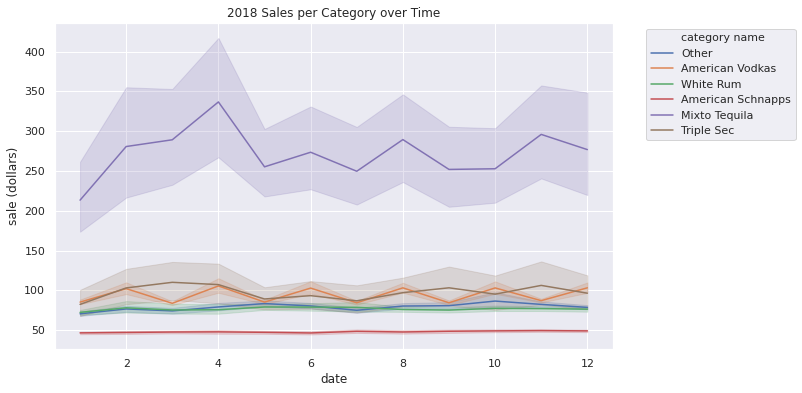

In [0]:
sns.set(rc={'figure.figsize':(10 ,6)})
df_2018_charts= df_2018.copy()

top5 = ['American Vodkas', 'White Rum', 'Mixto Tequila', 'American Schnapps', 'Triple Sec']
df_2018_charts['category name'] = df_2018_charts['category name'].apply(lambda x: x if x in top5 else 'Other')

ax = sns.lineplot(x=df_2018_charts['date'].dt.month, y=df_2018_charts['sale (dollars)'],
                  hue="category name", data=df_2018_charts)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2)
plt.title('2018 Sales per Category over Time')

In [0]:
# make a copy of df
df_2017_2= df_2017.copy()

# group by county and category name
grouped= df_2017_2.groupby(by= ['county','category name']).sum().reset_index()

# take only the cols I need 
df_2017_left_merge= grouped[['county', 'category name', 'sale (dollars)']]

# merge grouped sales with original copy of df 
df_2017_merged= pd.merge(df_2017_2, df_2017_left_merge, on=['county', 'category name'], how='left')
df_2017_merged

,invoice/item number,date,store number,store name,city,zip code,county number,category,category name,item number,item description,pack,bottle volume (ml),state bottle cost,state bottle retail,bottles sold,sale (dollars)_x,volume sold (liters),volume sold (gallons),year,population,total_ed,percent_ed,percent_under_25_ed,total_under_25_pop,total_over_25_pop,county,total_under_25_ed,percent_under_25_pop,percent_over_25_pop,percent_drink_pop,sale (dollars)_y
0,INV-08191800001,2017-10-23,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022,15,1062200,White Rum,45278,Paramount White Rum,6,1750,7.84,11.76,12,141.12,21.00,5.55,2017,13126,1849,13.9,4.4,873,9417,CASS,57754.4,6.7,71.7,78.4,5181.30
1,INV-02619900022,2017-01-09,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022,15,1031100,American Vodkas,36308,Hawkeye Vodka,6,1750,7.17,10.76,18,193.68,31.50,8.32,2017,13126,1849,13.9,4.4,873,9417,CASS,57754.4,6.7,71.7,78.4,17477.18
2,INV-02741900012,2017-01-17,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022,15,1031100,American Vodkas,36308,Hawkeye Vodka,6,1750,7.17,10.76,6,64.56,10.50,2.77,2017,13126,1849,13.9,4.4,873,9417,CASS,57754.4,6.7,71.7,78.4,17477.18
3,INV-02619900001,2017-01-09,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022,15,1062200,White Rum,45278,Paramount White Rum,6,1750,7.84,11.76,6,70.56,10.50,2.77,2017,13126,1849,13.9,4.4,873,9417,CASS,57754.4,6.7,71.7,78.4,5181.30
4,INV-02619900020,2017-01-09,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022,15,1031100,American Vodkas,36306,Hawkeye Vodka,12,750,3.34,5.01,12,60.12,9.00,2.38,2017,13126,1849,13.9,4.4,873,9417,CASS,57754.4,6.7,71.7,78.4,17477.18
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
198581,INV-09289400060,2017-12-18,5500,Farm Fresh Food Town &Liquor,Remsen,51050,75,1031100,American Vodkas,36668,Korski Vodka,6,1750,7.04,10.56,3,31.68,5.25,1.39,2017,25091,3528,16.0,13.2,1972,16763,PLYMOUTH,331201.2,7.9,66.8,74.7,24768.17
198582,INV-09289400006,2017-12-18,5500,Farm Fresh Food Town &Liquor,Remsen,51050,75,1012100,Canadian Whiskies,13038,Canadian Reserve Whisky,6,1750,9.00,13.50,6,81.00,10.50,2.77,2017,25091,3528,16.0,13.2,1972,16763,PLYMOUTH,331201.2,7.9,66.8,74.7,1247.12
198583,INV-09289400064,2017-12-18,5500,Farm Fresh Food Town &Liquor,Remsen,51050,75,1031100,American Vodkas,37217,Paramount Vodka,12,1000,4.25,6.38,6,38.28,6.00,1.59,2017,25091,3528,16.0,13.2,1972,16763,PLYMOUTH,331201.2,7.9,66.8,74.7,24768.17
198584,INV-09289400059,2017-12-18,5500,Farm Fresh Food Town &Liquor,Remsen,51050,75,1031100,American Vodkas,36667,Korski Vodka,12,1000,4.32,6.48,6,38.88,6.00,1.59,2017,25091,3528,16.0,13.2,1972,16763,PLYMOUTH,331201.2,7.9,66.8,74.7,24768.17


In [0]:
# do the same for 2018 
df_2018_2= df_2018.copy()
grouped= df_2018_2.groupby(by= ['county','category name']).sum().reset_index()
df_2018_left_merge= grouped[['county', 'category name', 'sale (dollars)']]
df_2018_merged= pd.merge(df_2018_2, df_2018_left_merge, on=['county', 'category name'], how='left')
df_2018_merged

,invoice/item number,date,store number,store name,city,zip code,county number,category,category name,item number,item description,pack,bottle volume (ml),state bottle cost,state bottle retail,bottles sold,sale (dollars)_x,volume sold (liters),volume sold (gallons),year,population,total_ed,percent_ed,percent_under_25_ed,total_under_25_pop,total_over_25_pop,county,total_under_25_ed,percent_under_25_pop,percent_over_25_pop,percent_drink_pop,sale (dollars)_y
0,INV-13533100006,2018-07-30,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022,15,1041100,American Dry Gins,31658,Paramount Gin,6,1750,7.11,10.67,12,128.04,21.00,5.55,2018,12930,1849,13.9,4.4,873,9417,CASS,56892.0,6.8,72.8,79.6,3557.70
1,INV-13533100009,2018-07-30,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022,15,1031100,American Vodkas,36308,Hawkeye Vodka,6,1750,7.17,10.76,24,258.24,42.00,11.10,2018,12930,1849,13.9,4.4,873,9417,CASS,56892.0,6.8,72.8,79.6,26458.35
2,INV-14208300002,2018-08-31,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022,15,1062200,White Rum,45278,Paramount White Rum,6,1750,7.84,11.76,6,70.56,10.50,2.77,2018,12930,1849,13.9,4.4,873,9417,CASS,56892.0,6.8,72.8,79.6,7582.44
3,INV-10070600008,2018-01-29,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022,15,1031100,American Vodkas,36308,Hawkeye Vodka,6,1750,7.17,10.76,12,129.12,21.00,5.55,2018,12930,1849,13.9,4.4,873,9417,CASS,56892.0,6.8,72.8,79.6,26458.35
4,INV-15802900011,2018-11-19,3833,Wal-Mart 3394 / Atlantic,Atlantic,50022,15,1031100,American Vodkas,36308,Hawkeye Vodka,6,1750,7.17,10.76,6,64.56,10.50,2.77,2018,12930,1849,13.9,4.4,873,9417,CASS,56892.0,6.8,72.8,79.6,26458.35
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
197929,INV-12254800039,2018-05-23,5540,Casey's General Store #2447 / Sergeant Bluff,Sergeant Bluff,51054,97,1031100,American Vodkas,36305,Hawkeye Vodka,12,750,3.34,5.01,6,30.06,4.50,1.19,2018,102539,15047,16.0,6.9,10162,65382,WOODBURY,707519.1,9.9,63.8,73.7,194333.64
197930,INV-12254800019,2018-05-23,5540,Casey's General Store #2447 / Sergeant Bluff,Sergeant Bluff,51054,97,1081400,American Schnapps,81206,Paramount Peppermint Schnapps,12,750,4.00,6.00,6,36.00,4.50,1.19,2018,102539,15047,16.0,6.9,10162,65382,WOODBURY,707519.1,9.9,63.8,73.7,22225.27
197931,INV-12254800038,2018-05-23,5540,Casey's General Store #2447 / Sergeant Bluff,Sergeant Bluff,51054,97,1031100,American Vodkas,36308,Hawkeye Vodka,6,1750,7.17,10.76,6,64.56,10.50,2.77,2018,102539,15047,16.0,6.9,10162,65382,WOODBURY,707519.1,9.9,63.8,73.7,194333.64
197932,INV-12254800020,2018-05-23,5540,Casey's General Store #2447 / Sergeant Bluff,Sergeant Bluff,51054,97,1062200,White Rum,45275,Paramount White Rum Traveler,12,750,4.00,6.00,3,18.00,2.25,0.59,2018,102539,15047,16.0,6.9,10162,65382,WOODBURY,707519.1,9.9,63.8,73.7,42185.90


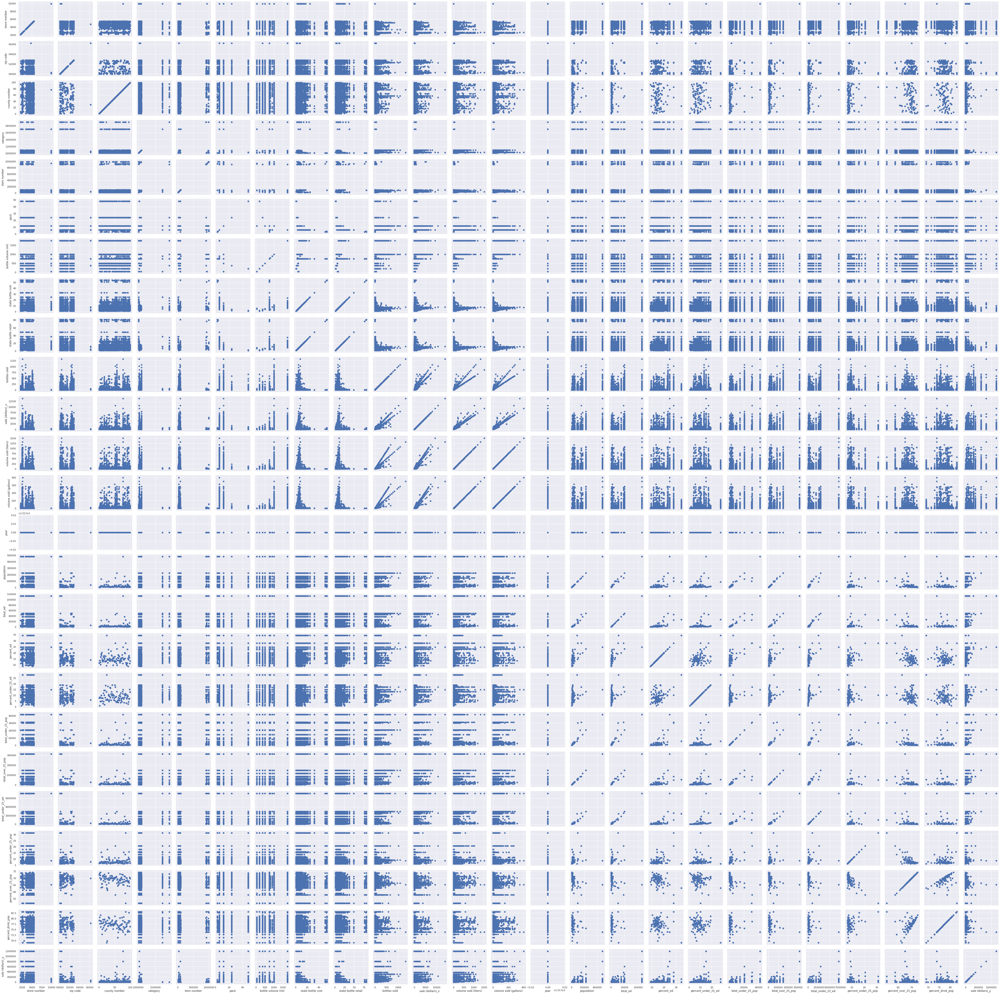

In [0]:
# ensure no features a linear relationship with my target variable 2017
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()

g = sns.PairGrid(df_2017_merged)
g = g.map(plt.scatter)

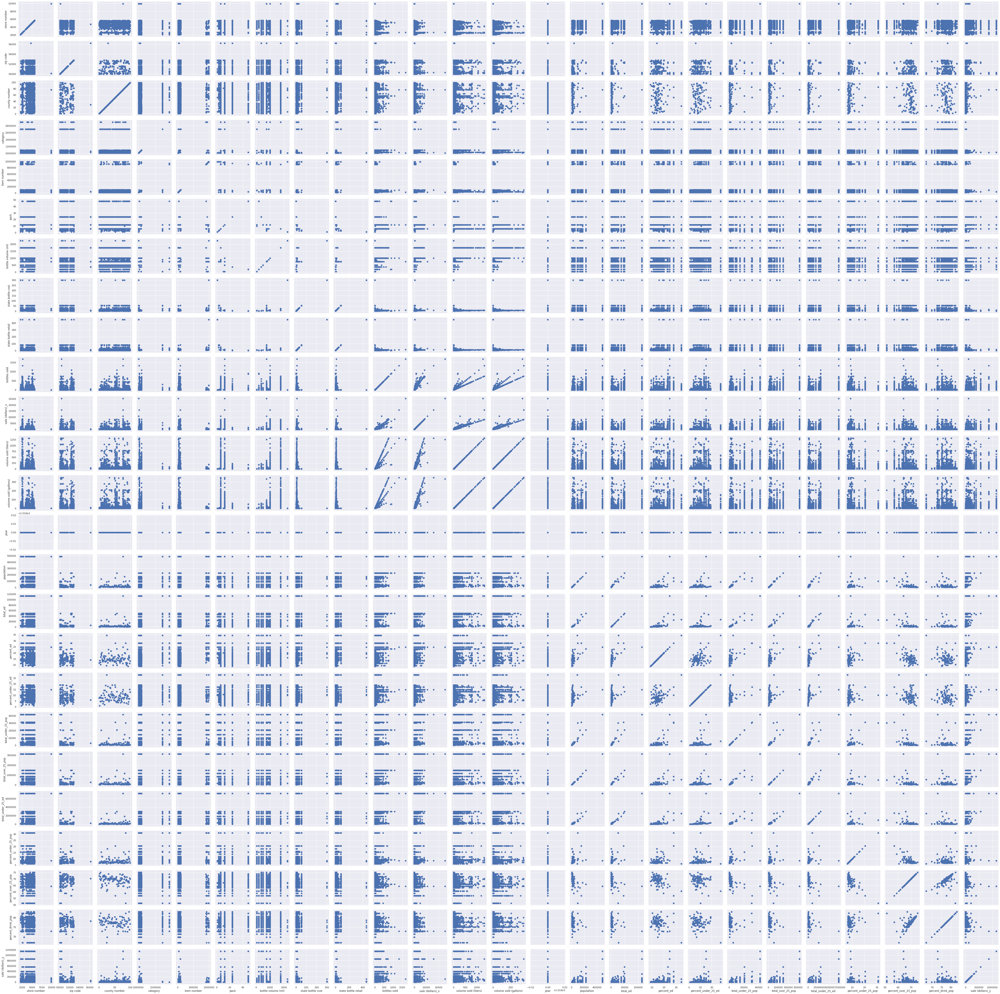

In [0]:
# ensure no features a linear relationship with my target variable 2018
g = sns.PairGrid(df_2018_merged)
g = g.map(plt.scatter)

## Modeling

### random forest with percent measures

In [0]:
# run a random forest with percent measures 
from sklearn.ensemble import RandomForestRegressor

X= df_2017_merged[['bottle volume (ml)', 'category', 'percent_ed', 'percent_under_25_ed', 'percent_under_25_pop',
       'percent_over_25_pop']]
Y= df_2017_merged['sale (dollars)_y']

X_test= df_2018_merged[['bottle volume (ml)', 'category', 'percent_ed', 'percent_under_25_ed', 'percent_under_25_pop',
       'percent_over_25_pop']]
Y_test= df_2018_merged['sale (dollars)_y']

rfr=RandomForestRegressor()
rfr.fit(X, Y)

print(rfr.score(X, Y))
print(rfr.score(X_test, Y_test))

0.999998245077365
0.9970452755695539


In [0]:
# goodness of percent model metrics
from sklearn.metrics import mean_absolute_error
from statsmodels.tools.eval_measures import mse, rmse

Y_preds_train = rfr.predict(X)
Y_preds_test = rfr.predict(X_test)

print("Mean absolute error of the prediction is: {}".format(mean_absolute_error(Y_test, Y_preds_test)))
print("Mean squared error of the prediction is: {}".format(mse(Y_test, Y_preds_test)))
print("Root mean squared error of the prediction is: {}".format(rmse(Y_test, Y_preds_test)))
print("Mean absolute percentage error of the prediction is: {}".format(np.mean(np.abs((Y_test - Y_preds_test) / Y_test)) * 100))

Mean absolute error of the prediction is: 9158.241930171554
Mean squared error of the prediction is: 357972408.43242776
Root mean squared error of the prediction is: 18920.158784545856
Mean absolute percentage error of the prediction is: 25.57734649620637


###random forest with total measures

In [0]:
# run a random forest with total measures 

X= df_2017_merged[['bottle volume (ml)', 'category', 'total_ed', 'total_under_25_ed', 'total_under_25_pop',
       'total_over_25_pop']]
Y= df_2017_merged['sale (dollars)_y']

X_test= df_2018_merged[['bottle volume (ml)', 'category', 'total_ed', 'total_under_25_ed', 'total_under_25_pop',
       'total_over_25_pop']]
Y_test= df_2018_merged['sale (dollars)_y']

rfr1=RandomForestRegressor()
rfr1.fit(X, Y)

print(rfr1.score(X, Y))
print(rfr1.score(X_test, Y_test))

0.9999980715373971
0.998303542419594


In [0]:
# goodness of total model measures 
Y_preds_train = rfr1.predict(X)
Y_preds_test = rfr1.predict(X_test)

print("Mean absolute error of the prediction is: {}".format(mean_absolute_error(Y_test, Y_preds_test)))
print("Mean squared error of the prediction is: {}".format(mse(Y_test, Y_preds_test)))
print("Root mean squared error of the prediction is: {}".format(rmse(Y_test, Y_preds_test)))
print("Mean absolute percentage error of the prediction is: {}".format(np.mean(np.abs((Y_test - Y_preds_test) / Y_test)) * 100))

Mean absolute error of the prediction is: 7867.923363762806
Mean squared error of the prediction is: 255394956.17519423
Root mean squared error of the prediction is: 15981.08119543838
Mean absolute percentage error of the prediction is: 21.9966319211855


In [0]:
# run a grid search for random forest with total measures 
from sklearn.model_selection import GridSearchCV

rfrCV= RandomForestRegressor()

X= df_2017_merged[['bottle volume (ml)', 'category', 'total_ed', 'total_under_25_ed', 'total_under_25_pop',
       'total_over_25_pop']]
Y= df_2017_merged['sale (dollars)_y']

params = {'max_depth': [3, 4, 5], 'n_estimators':[200, 300, 400]}

grid = GridSearchCV(rfrCV, param_grid=params, cv=5)

grid.fit(X, Y)
print(grid.best_params_)
print(grid.best_score_)

{'max_depth': 5, 'n_estimators': 400}
0.9913001228655366


In [0]:
# rerun total measures random forest with tuned parameters 

X= df_2017_merged[['bottle volume (ml)', 'category', 'total_ed', 'total_under_25_ed', 'total_under_25_pop',
       'total_over_25_pop']]
Y= df_2017_merged['sale (dollars)_y']

X_test= df_2018_merged[['bottle volume (ml)', 'category', 'total_ed', 'total_under_25_ed', 'total_under_25_pop',
       'total_over_25_pop']]
Y_test= df_2018_merged['sale (dollars)_y']

rfr1=RandomForestRegressor(max_depth= 5, n_estimators=300)
rfr1.fit(X, Y)

print(rfr1.score(X, Y))
print(rfr1.score(X_test, Y_test))

0.9930877151437205
0.9903726790125182


In [0]:
# goodness of tuned model 
Y_preds_train = rfr1.predict(X)
Y_preds_test = rfr1.predict(X_test)

print("Mean absolute error of the prediction is: {}".format(mean_absolute_error(Y_test, Y_preds_test)))
print("Mean squared error of the prediction is: {}".format(mse(Y_test, Y_preds_test)))
print("Root mean squared error of the prediction is: {}".format(rmse(Y_test, Y_preds_test)))
print("Mean absolute percentage error of the prediction is: {}".format(np.mean(np.abs((Y_test - Y_preds_test) / Y_test)) * 100))

Mean absolute error of the prediction is: 19868.10461452534
Mean squared error of the prediction is: 815208604.8952391
Root mean squared error of the prediction is: 28551.858168869483
Mean absolute percentage error of the prediction is: 265.02555348210325


In [0]:
# get feature importances 
from sklearn.feature_selection import SelectFromModel

sfm = SelectFromModel(rfr1, threshold=.05)

sfm.fit(X, Y)

x_cols= X.columns

important = []
for feature_list_index in sfm.get_support(indices=True):
    important.append(x_cols[feature_list_index])

print(important)

['category', 'total_ed', 'total_under_25_pop']


In [0]:
# run another random forest with only 'important' features
X2= df_2017_merged[['category', 'total_ed', 'total_under_25_pop']]
Y2= df_2017_merged['sale (dollars)_y']

X_test2= df_2018_merged[['category', 'total_ed', 'total_under_25_pop']]
Y_test2= df_2018_merged['sale (dollars)_y']

rfr2=RandomForestRegressor(max_depth= 5, n_estimators=300)
rfr2.fit(X2, Y2)

print(rfr2.score(X2, Y2))
print(rfr2.score(X_test2, Y_test2))

0.9926618211026307
0.9915102778802228


In [0]:
# goodness of model measures 
Y_preds_train = rfr2.predict(X2)
Y_preds_test = rfr2.predict(X_test2)

print("Mean absolute error of the prediction is: {}".format(mean_absolute_error(Y_test, Y_preds_test)))
print("Mean squared error of the prediction is: {}".format(mse(Y_test, Y_preds_test)))
print("Root mean squared error of the prediction is: {}".format(rmse(Y_test, Y_preds_test)))
print("Mean absolute percentage error of the prediction is: {}".format(np.mean(np.abs((Y_test - Y_preds_test) / Y_test)) * 100))

Mean absolute error of the prediction is: 19754.945933289004
Mean squared error of the prediction is: 826901276.4699781
Root mean squared error of the prediction is: 28755.891161116502
Mean absolute percentage error of the prediction is: 204.35608486771807


###xgboost model with percent inputs 

In [0]:
# run xgboost model with percent inputs 
from sklearn.ensemble import GradientBoostingRegressor


X= df_2017_merged[['bottle volume (ml)', 'category', 'percent_ed', 'percent_under_25_ed', 'percent_under_25_pop',
       'percent_over_25_pop']]
Y= df_2017_merged['sale (dollars)_y']

X_test= df_2018_merged[['bottle volume (ml)', 'category', 'percent_ed', 'percent_under_25_ed', 'percent_under_25_pop',
       'percent_over_25_pop']]
Y_test= df_2018_merged['sale (dollars)_y']


gbr = GradientBoostingRegressor()
gbr.fit(X,Y)

print(gbr.score(X, Y))
print(gbr.score(X_test, Y_test))

0.984188949803705
0.9831203657099049


In [0]:
# run a grid search
from sklearn.model_selection import GridSearchCV

gbrCV = GradientBoostingRegressor()

X= df_2017_merged[['bottle volume (ml)', 'category', 'percent_ed', 'percent_under_25_ed', 'percent_under_25_pop',
       'percent_over_25_pop']]
Y= df_2017_merged['sale (dollars)_y']

params = {'max_depth': [2, 3, 4], 'learning_rate':[.1, .3], 'n_iter_no_change':[5, 10, 15] }

grid = GridSearchCV(gbrCV, param_grid=params, cv=5)

grid.fit(X, Y)
print(grid.best_params_)
print(grid.best_score_)

{'learning_rate': 0.3, 'max_depth': 4, 'n_iter_no_change': 15}
0.9988524906699231


In [0]:
# rerun percents xgboost model with tuned parameters
from sklearn.ensemble import GradientBoostingRegressor


X= df_2017_merged[['bottle volume (ml)', 'category', 'percent_ed', 'percent_under_25_ed', 'percent_under_25_pop',
       'percent_over_25_pop']]
Y= df_2017_merged['sale (dollars)_y']

X_test= df_2018_merged[['bottle volume (ml)', 'category', 'percent_ed', 'percent_under_25_ed', 'percent_under_25_pop',
       'percent_over_25_pop']]
Y_test= df_2018_merged['sale (dollars)_y']


gbr = GradientBoostingRegressor(learning_rate= 0.3, max_depth= 4, n_iter_no_change= 15)
gbr.fit(X,Y)

print(gbr.score(X, Y))
print(gbr.score(X_test, Y_test))

0.9993548576311302
0.9956516932253623


In [0]:
# compare goodness of model metrics
Y_preds_train = gbr.predict(X)
Y_preds_test = gbr.predict(X_test)

print("Mean absolute error of the prediction is: {}".format(mean_absolute_error(Y_test, Y_preds_test)))
print("Mean squared error of the prediction is: {}".format(mse(Y_test, Y_preds_test)))
print("Root mean squared error of the prediction is: {}".format(rmse(Y_test, Y_preds_test)))
print("Mean absolute percentage error of the prediction is: {}".format(np.mean(np.abs((Y_test - Y_preds_test) / Y_test)) * 100))

Mean absolute error of the prediction is: 11838.862944257935
Mean squared error of the prediction is: 368199741.5499208
Root mean squared error of the prediction is: 19188.531511033376
Mean absolute percentage error of the prediction is: 178.7503863254313


In [0]:
# run xgboost model with only important percent inputs 

X= df_2017_merged[['category', 'percent_ed', 'percent_under_25_pop']]
Y= df_2017_merged['sale (dollars)_y']

X_test= df_2018_merged[['category', 'percent_ed', 'percent_under_25_pop']]
Y_test= df_2018_merged['sale (dollars)_y']


gbr = GradientBoostingRegressor()
gbr.fit(X,Y)

print(gbr.score(X, Y))
print(gbr.score(X_test, Y_test))

0.9825556176891078
0.9806843171482154


In [0]:
# run a grid search
from sklearn.model_selection import GridSearchCV

gbrCV = GradientBoostingRegressor()

X= df_2017_merged[['category', 'percent_ed', 'percent_under_25_pop']]
Y= df_2017_merged['sale (dollars)_y']

params = {'max_depth': [2, 3, 4], 'learning_rate':[.1, .3], 'n_iter_no_change':[5, 10, 15] }

grid = GridSearchCV(gbrCV, param_grid=params, cv=5)

grid.fit(X, Y)
print(grid.best_params_)
print(grid.best_score_)

{'learning_rate': 0.3, 'max_depth': 4, 'n_iter_no_change': 10}
0.9988057521847475


In [0]:
# rerun percents xgboost model with tuned parameters
from sklearn.ensemble import GradientBoostingRegressor


X= df_2017_merged[['category', 'percent_ed', 'percent_under_25_pop']]
Y= df_2017_merged['sale (dollars)_y']

X_test= df_2018_merged[['category', 'percent_ed', 'percent_under_25_pop']]
Y_test= df_2018_merged['sale (dollars)_y']


gbr = GradientBoostingRegressor(learning_rate= 0.3, max_depth= 4, n_iter_no_change= 10)
gbr.fit(X,Y)

print(gbr.score(X, Y))
print(gbr.score(X_test, Y_test))

0.9991937935021056
0.9964333611680989


In [0]:
# compare goodness of model metrics
Y_preds_train = gbr.predict(X)
Y_preds_test = gbr.predict(X_test)

print("Mean absolute error of the prediction is: {}".format(mean_absolute_error(Y_test, Y_preds_test)))
print("Mean squared error of the prediction is: {}".format(mse(Y_test, Y_preds_test)))
print("Root mean squared error of the prediction is: {}".format(rmse(Y_test, Y_preds_test)))
print("Mean absolute percentage error of the prediction is: {}".format(np.mean(np.abs((Y_test - Y_preds_test) / Y_test)) * 100))

Mean absolute error of the prediction is: 10687.22915604308
Mean squared error of the prediction is: 301292463.9698408
Root mean squared error of the prediction is: 17357.778197967644
Mean absolute percentage error of the prediction is: 161.54060541159313


In [0]:
# calculate RMSE as a percentage of total sales for 2018
(17357.77/17420013.48)*100

0.0996426898287337